# Part 1 - Convolutional Neural Networks for CIFAR-10


In this notebook chapter, we'll build, train and optimize a neural network to classify images of the CIFAR-10 dataset using convolutional neural networks.

This guide uses [tf.keras](https://www.tensorflow.org/guide/keras), a high-level API to build and train models in TensorFlow.


In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
from __future__ import absolute_import, division, print_function, unicode_literals

# Import TensorFlow and TensorFlow Datasets
import tensorflow as tf
print(tf.__version__)

# Helper libraries
import math
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.datasets import cifar10
from tensorflow.keras.utils import to_categorical

# load dataset
(X_train, y_train), (X_test, y_test) = cifar10.load_data()
X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

class_names = ['airplanes', 'cars', 'birds', 'cats', 'deer',
               'dogs',      'frogs',   'horses',  'ships',   'trucks']
num_classes = len(class_names)


# summarize loaded dataset
print('Train: X=%s, y=%s' % (X_train.shape, y_train.shape))
print('Test: X=%s, y=%s' % (X_test.shape, y_test.shape))
y_train_cat = to_categorical(y_train, 10)
y_test_cat  = to_categorical(y_test, 10)
print(y_train.shape)
print(y_test.shape)
print(y_train_cat.shape)
print(y_test_cat.shape)

2.18.0
170498071/170498071 ━━━━━━━━━━━━━━━━━━━━ 134s 1us/step
Train: X=(50000, 32, 32, 3), y=(50000, 1)
Test: X=(10000, 32, 32, 3), y=(10000, 1)
(50000, 1)
(10000, 1)
(50000, 10)
(10000, 10)


## 1.1 Preprocess the data

### 1.1.1 Zero-Centered Images

The value of each pixel in the image data is an integer in the range `[0,255]`. For the model to work properly, these values need to be zero-centered to the range. So here we compute the mean value per colour channel over all training images and subtract the mean value per colour channel from every image in the training and test set.

In [3]:
train_mean = X_train.mean(axis=(0,1,2))
train_std =  X_train.std(axis=(0,1,2))
print(train_mean)
X_train_zc = X_train - train_mean
X_test_zc  = X_test - train_mean


print(X_train_zc[3].mean(axis=(0,1)))
print(X_train_zc[3].shape)
print(X_train_zc.shape)
print(X_test_zc.shape)
print(X_train_zc.dtype)

[125.3069  122.95015 113.866  ]
[-25.327402 -39.670845 -56.451923]
(32, 32, 3)
(50000, 32, 32, 3)
(10000, 32, 32, 3)
float32


### 1.1.2 Data Augmentation

In [4]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image


train_datagen = ImageDataGenerator(
        # set input mean to 0 over the dataset
        featurewise_center=False,
        # set each sample mean to 0
        samplewise_center=False,
        # divide inputs by std of the dataset
        featurewise_std_normalization=False,
        # divide each input by its std
        samplewise_std_normalization=False,
        # apply ZCA whitening
        zca_whitening=False,
        # epsilon for ZCA whitening
        zca_epsilon=1e-06,
        # randomly rotate images in the range (degrees, 0 to 180)
        rotation_range=0,
        # randomly shift images horizontally (fraction of total width)
        width_shift_range=0.1,
        # randomly shift images vertically (fraction of total height)
        height_shift_range=0.1,
        # set range for random shear
        shear_range=0.,
        # set range for random zoom
        zoom_range=0.,
        # set range for random channel shifts
        # set mode for filling points outside the input boundaries
        channel_shift_range=0.,
        # value used for fill_mode = "constant"
        fill_mode='nearest',
        cval=0.,
        # randomly flip images
        horizontal_flip=True,
        # randomly flip images
        vertical_flip=False,
        # set rescaling factor (applied before any other transformation)
        rescale=None,
        # set function that will be applied on each input
        preprocessing_function=None,
        # image data format, either "channels_first" or "channels_last"
        data_format=None,
        # fraction of images reserved for validation (strictly between 0 and 1)
        validation_split=0.0)

validation_datagen = ImageDataGenerator(
      # rescale the pixel values (between 0 and 255) to the [0,1] interval
      # rescale=1./255
)


## 2. Build the model

Building the neural network requires configuring the layers of the model, then compiling the model.

### 1.2.1 Define the network

The basic building block of a neural network is the *layer*. A layer extracts a representation from the data fed into it. Hopefully, a series of connected layers results in a representation that is meaningful for the problem at hand.

Much of deep learning consists of chaining together simple layers. Most layers, like `tf.keras.layers.Dense`, have internal parameters which are adjusted ("learned") during training.

In [5]:
model = tf.keras.Sequential()
model.add(tf.keras.layers.InputLayer((32, 32, 3)))
model.add(tf.keras.layers.Conv2D(32, (3, 3), padding='same'))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.Conv2D(32, (3, 3)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
model.add(tf.keras.layers.Dropout(0.25))

model.add(tf.keras.layers.Conv2D(64, (3, 3), padding='same'))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.Conv2D(64, (3, 3)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
model.add(tf.keras.layers.Dropout(0.25))

model.add(tf.keras.layers.Flatten())
model.add(tf.keras.layers.Dense(512))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('relu'))
model.add(tf.keras.layers.Dropout(0.5))
model.add(tf.keras.layers.Dense(num_classes))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Activation('softmax'))

`tf.keras.layers.Conv2D(32, (3, 3)))` implies the following parameter settings:


- `filters` : Integer, the dimensionality of the output space (i.e. the number of output filters in the
convolution). In this case, the number of filters is $32$.

- `kernel_size` : An integer or tuple/list of 2 integers, specifying the height and width of the 2D convolution window (receptive field). Can be a single integer to specify the same value for all spatial dimensions. In this
case, the receptive field of the filters are $3\times3$.

- `strides` : An integer or tuple/list of 2 integers, specifying the strides of the convolution along the height and width. Can be a single integer to specify the same value for all spatial dimensions. Default strides : $(1, 1)$

- `padding`: one of `valid` or `same`. In this case, the size of the output volume won't be changed.

`tf.keras.layers.MaxPooling2D(pool_size=(2, 2))` implies the following parameter settings:

- `pool_size`: integer or tuple of 2 integers, factors by which to downscale (vertical, horizontal). $(2, 2)$ will halve the input in both spatial dimension. If only one integer is specified, the same window length will be used for both dimensions.
- `strides`: Integer, tuple of 2 integers, or `None`. `strides` values. If `None`, it will default to `pool_size`. In this case $(2,2)$.

In [6]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 32, 32, 32)          │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 32, 32, 32)          │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation (Activation)              │ (None, 32, 32, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 30, 30, 32)          │           9,248 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 30, 30, 32)          │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation_1 (Activation)            │ (None, 30, 30, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 15, 15, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 15, 15, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 15, 15, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 15, 15, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation_2 (Activation)            │ (None, 15, 15, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 13, 13, 64)          │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_3                │ (None, 13, 13, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ activation_3 (Activation)            │ (None, 13, 13, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 6, 6, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 6, 6, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 2304)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 512)                 │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_4                │ (None, 512)                 │           2,048 │
│ (BatchNormalization)                 │                             │              

 Total params: 1,253,714 (4.78 MB)

 Trainable params: 1,252,286 (4.78 MB)

 Non-trainable params: 1,428 (5.58 KB)

### 1.2.2 Compile and Fit the Network

In [7]:
import datetime, os
logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

# Compile Network
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

num_validation_examples = 1000
num_train_examples = 5000


train_iterator = train_datagen.flow(X_train_zc[num_validation_examples:num_train_examples],
                                    y_train_cat[num_validation_examples:num_train_examples],
                                    batch_size=32)
validation_iterator = validation_datagen.flow(X_train_zc[:num_validation_examples:],
                                              y_train_cat[:num_validation_examples:],
                                              batch_size=32)

# Fit Network
history = model.fit(train_iterator,
                              validation_data = validation_iterator,
                              epochs=100,
                              steps_per_epoch=len(train_iterator),
                              callbacks=[tensorboard_callback])


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 16s 45ms/step - accuracy: 0.1578 - loss: 2.4368 - val_accuracy: 0.3280 - val_loss: 1.9255
Epoch 2/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - accuracy: 0.2689 - loss: 2.0084 - val_accuracy: 0.3620 - val_loss: 1.8124
Epoch 3/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - accuracy: 0.2989 - loss: 1.8955 - val_accuracy: 0.3890 - val_loss: 1.7394
Epoch 4/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 3s 21ms/step - accuracy: 0.3339 - loss: 1.8223 - val_accuracy: 0.4190 - val_loss: 1.6618
Epoch 5/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 3s 21ms/step - accuracy: 0.3534 - loss: 1.7749 - val_accuracy: 0.4200 - val_loss: 1.6519
Epoch 6/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - accuracy: 0.3544 - loss: 1.7657 - val_accuracy: 0.4390 - val_loss: 1.5999
Epoch 7/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - accuracy: 0.3888 - loss: 1.7118 - val_accuracy: 0.4390 - val_loss: 1.5786
Epoch 8/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - accuracy: 0.3898 - loss: 1.6904 -

### 1.2.3 Evaluate the Network on the test dataset

In [8]:
model.evaluate(X_test_zc, y_test_cat)

313/313 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.6480 - loss: 1.0388


[1.0388946533203125, 0.6488000154495239]

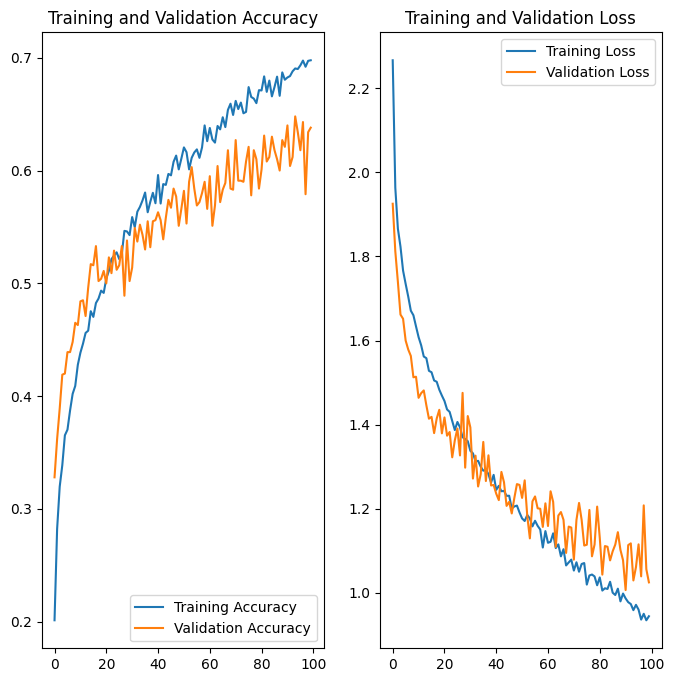

In [9]:
# Plot training and validation accuracy
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(100)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

In [10]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [11]:
os.makedirs(logdir, exist_ok=True)
%tensorboard --logdir logs


Output hidden; open in https://colab.research.google.com to view.

### Save the model

In [12]:
import os
base_folder = 'data'
# Check if the directory exists, if not, create it
if not os.path.exists(f"./{base_folder}"):
  os.makedirs(f"./{base_folder}")

model.save(f'./{base_folder}/cifar_10_convnets_1.keras')

## Part 1.2 - Dogs vs Cats Image Classification : Visualizing what ConvNets learn?

In this notebook chapter, we will discuss how to classify images into pictures of cats or pictures of dogs. We'll build an image classifier using `tf.keras.Sequential` model and load data using `tf.keras.preprocessing.image.ImageDataGenerator`. At the end, we will visualize filters and intermediate activation layers.

### 1.2.1 Specific concepts that will be covered:
In the process, we will build practical experience and develop intuition around the following concepts

* Building _data input pipelines_ using the `tf.keras.preprocessing.image.ImageDataGenerator` class — How can we efficiently work with data on disk to interface with our model?
* _Overfitting_ - what is it, how to identify it, and how can we prevent it?
* _Data Augmentation_ and _Dropout_ - Key techniques to fight overfitting in computer vision tasks that we will incorporate into our data pipeline and image classifier model.
* _Visualizing ConvNet filters_
* _Visualizing intermediate activations_


#### We will follow the general machine learning workflow:

1. Examine and understand data
2. Build an input pipeline
3. Build our model
4. Train our model
5. Test our model
6. Improve our model/Repeat the process

<hr>




### 1.2.2 Importing packages

Let's start by importing required packages:

*   os — to read files and directory structure
*   numpy — for some matrix math outside of TensorFlow
*   matplotlib.pyplot — to plot the graph and display images in our training and validation data

In [13]:
from __future__ import absolute_import, division, print_function, unicode_literals

import os
import numpy as np
import matplotlib.pyplot as plt

In [14]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator

### 1.2.3 Data Loading

To build our image classifier, we begin by downloading the dataset. The dataset we are using is a filtered version of <a href="https://www.kaggle.com/c/dogs-vs-cats/data" target="_blank">Dogs vs. Cats</a> dataset from Kaggle (ultimately, this dataset is provided by Microsoft Research).

In this Jupyter Notebook however, we will make use of the class `tf.keras.preprocessing.image.ImageDataGenerator` which will read data from disk. We therefore need to directly download *Dogs vs. Cats* from a URL and unzip it to your computers filesystem.

In [15]:
import os
import zipfile

_URL = 'https://storage.googleapis.com/mledu-datasets/cats_and_dogs_filtered.zip'

zip_dir = tf.keras.utils.get_file('cats_and_dogs_filterted.zip',
                                   origin=_URL,
                                   extract=False,
                                   cache_subdir='/content/')
data_dir = '/content/data'
with zipfile.ZipFile(zip_dir, 'r') as zip_ref:
    zip_ref.extractall(data_dir) # Extract to desired folder

print(data_dir)


68606236/68606236 ━━━━━━━━━━━━━━━━━━━━ 4s 0us/step
/content/data


The dataset we have downloaded has following directory structure.

<pre style="font-size: 10.0pt; font-family: Arial; line-height: 2; letter-spacing: 1.0pt;" >
<b>cats_and_dogs_filtered</b>
|__ <b>train</b>
    |______ <b>cats</b>: [cat.0.jpg, cat.1.jpg, cat.2.jpg ....]
    |______ <b>dogs</b>: [dog.0.jpg, dog.1.jpg, dog.2.jpg ...]
|__ <b>validation</b>
    |______ <b>cats</b>: [cat.2000.jpg, cat.2001.jpg, cat.2002.jpg ....]
    |______ <b>dogs</b>: [dog.2000.jpg, dog.2001.jpg, dog.2002.jpg ...]
</pre>

We'll now assign variables with the proper file path for the training and validation sets.

In [16]:
print(data_dir)
base_dir = os.path.join(data_dir, 'cats_and_dogs_filtered')
print(base_dir)
train_dir = os.path.join(base_dir, 'train')
print(train_dir)
validation_dir = os.path.join(base_dir, 'validation')
print(validation_dir)


/content/data
/content/data/cats_and_dogs_filtered
/content/data/cats_and_dogs_filtered/train
/content/data/cats_and_dogs_filtered/validation


In [17]:
train_cats_dir = os.path.join(train_dir, 'cats')  # directory with our training cat pictures
print(train_cats_dir)
train_dogs_dir = os.path.join(train_dir, 'dogs')  # directory with our training dog pictures
print(train_dogs_dir)
validation_cats_dir = os.path.join(validation_dir, 'cats')  # directory with our validation cat pictures
print(validation_cats_dir)
validation_dogs_dir = os.path.join(validation_dir, 'dogs')  # directory with our validation dog pictures
print(validation_dogs_dir)

/content/data/cats_and_dogs_filtered/train/cats
/content/data/cats_and_dogs_filtered/train/dogs
/content/data/cats_and_dogs_filtered/validation/cats
/content/data/cats_and_dogs_filtered/validation/dogs


### 1.2.4 Understanding our data

Let's look at how many cats and dogs images we have in our training and validation directory

In [18]:
num_cats_tr = len(os.listdir(train_cats_dir))
num_dogs_tr = len(os.listdir(train_dogs_dir))

num_cats_val = len(os.listdir(validation_cats_dir))
num_dogs_val = len(os.listdir(validation_dogs_dir))

total_train = num_cats_tr + num_dogs_tr
total_val = num_cats_val + num_dogs_val

In [19]:
print('total training cat images:', num_cats_tr)
print('total training dog images:', num_dogs_tr)

print('total validation cat images:', num_cats_val)
print('total validation dog images:', num_dogs_val)
print("--")
print("Total training images:", total_train)
print("Total validation images:", total_val)

total training cat images: 1000
total training dog images: 1000
total validation cat images: 500
total validation dog images: 500
--
Total training images: 2000
Total validation images: 1000


### 1.2.5 Setting Model Parameters

For convenience, let us set up variables that will be used later while pre-processing our dataset and training our network.

In [20]:
BATCH_SIZE = 128
IMG_SHAPE  = 150 # Our training data consists of images with width of 150 pixels and height of 150 pixels

After defining our generators for training and validation images, `flow_from_directory` method will load images from the disk and will apply rescaling and will resize them into required dimensions using single line of code.

## 1.3 Data Augmentation

Overfitting often occurs when we have a small number of training examples. One way to fix this problem is to augment our dataset so that it has sufficient number and variety of training examples. Data augmentation takes the approach of generating more training data from existing training samples, by augmenting the samples through random transformations that yield believable-looking images. The goal is that at training time, your model will never see the exact same picture twice. This exposes the model to more aspects of the data, allowing it to generalize better.

In `tf.keras` we can implement this using the same `ImageDataGenerator` class we used in the last teaching unit. We can simply pass different transformations we want to our dataset as a form of arguments and it will take care of applying it to the dataset during our training process.

To start off, let's define a function that can display an image, so we can see the type of augmentation that has been performed. Then, we'll look at specific augmentations that we'll use during training.

In [21]:
# This function will plot images in the form of a grid with 1 row and 5 columns where images are placed in each column.
def plotImages(images_arr):
    fig, axes = plt.subplots(1, 5, figsize=(20,20))
    axes = axes.flatten()
    for img, ax in zip(images_arr, axes):
        ax.imshow(img)
    plt.tight_layout()
    plt.show()

### 1.3.1 Flipping the image horizontally

We can begin by randomly applying horizontal flip augmentation to our dataset and seeing how individual images will look after the transformation. This is achieved by passing `horizontal_flip=True` as an argument to the `ImageDataGenerator` class.

In [22]:
image_gen = ImageDataGenerator(rescale=1./255, horizontal_flip=True)

train_data_gen = image_gen.flow_from_directory(batch_size=BATCH_SIZE,
                                               directory=train_dir,
                                               shuffle=True,
                                               target_size=(IMG_SHAPE,IMG_SHAPE))

Found 2000 images belonging to 2 classes.


from `IPython.display` import `display`, `ImageTo` see the transformation in action, let's take one sample image from our training set and repeat it five times. The augmentation will be randomly applied (or not) to each repetition.

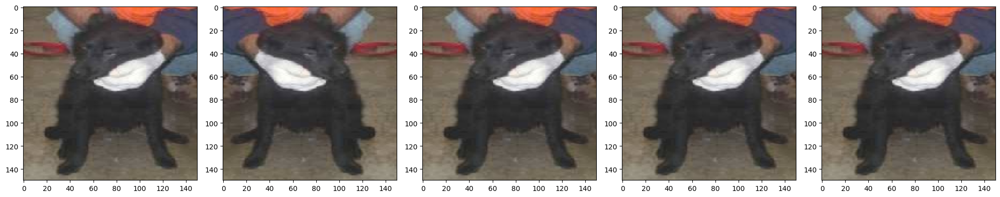

In [23]:
from PIL import Image
# if not installed, execute !pip3 install pillow
# then restart kernel
import PIL.Image
augmented_images = [train_data_gen[0][0][0] for i in range(5)]
plotImages(augmented_images)

### 1.3.2 Rotating the image

The rotation augmentation will randomly rotate the image up to a specified number of degrees. Here, we'll set it to 45.

In [24]:
image_gen = ImageDataGenerator(rescale=1./255, rotation_range=45)

train_data_gen = image_gen.flow_from_directory(batch_size=BATCH_SIZE,
                                               directory=train_dir,
                                               shuffle=True,
                                               target_size=(IMG_SHAPE, IMG_SHAPE))

Found 2000 images belonging to 2 classes.


To see the transformation in action, let's once again take a sample image from our training set and repeat it. The augmentation will be randomly applied (or not) to each repetition.

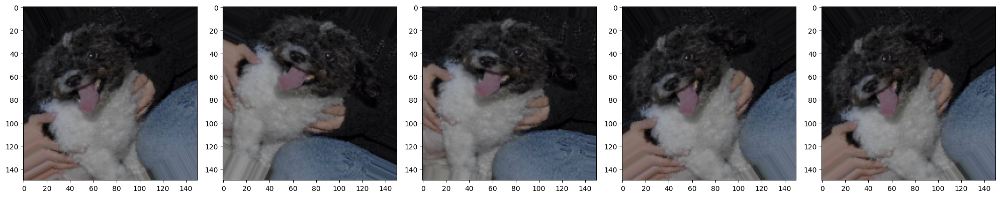

In [25]:
augmented_images = [train_data_gen[0][0][0] for i in range(5)]
plotImages(augmented_images)

### 1.3.3 Applying Zoom

We can also apply Zoom augmentation to our dataset, zooming images up to 50% randomly.

In [26]:
image_gen = ImageDataGenerator(rescale=1./255, zoom_range=0.5)

train_data_gen = image_gen.flow_from_directory(batch_size=BATCH_SIZE,
                                               directory=train_dir,
                                               shuffle=True,
                                               target_size=(IMG_SHAPE, IMG_SHAPE))


Found 2000 images belonging to 2 classes.


One more time, take a sample image from our training set and repeat it. The augmentation will be randomly applied (or not) to each repetition.

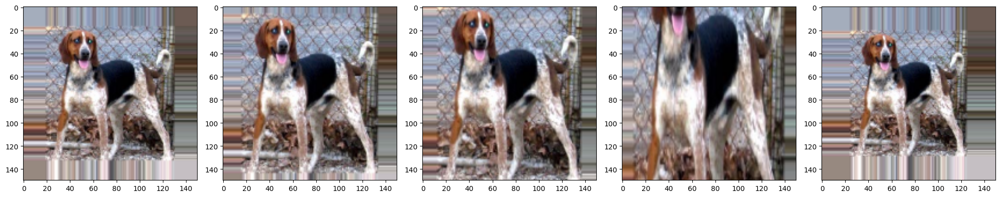

In [27]:
augmented_images = [train_data_gen[0][0][0] for i in range(5)]
plotImages(augmented_images)

### 1.3.4 Putting it all together

We can apply all these augmentations, and even others, with just one line of code, by passing the augmentations as arguments with proper values.

Here, we have applied rescale, rotation of 45 degrees, width shift, height shift, horizontal flip, and zoom augmentation to our training images.

In [28]:
image_gen_train = ImageDataGenerator(
      rescale=1./255,
      rotation_range=40,
      width_shift_range=0.2,
      height_shift_range=0.2,
      shear_range=0.2,
      zoom_range=0.2,
      horizontal_flip=True,
      fill_mode='nearest')

train_data_gen = image_gen_train.flow_from_directory(batch_size=BATCH_SIZE,
                                                     directory=train_dir,
                                                     shuffle=True,
                                                     target_size=(IMG_SHAPE,IMG_SHAPE),
                                                     class_mode='binary')

Found 2000 images belonging to 2 classes.


Let's visualize how a single image would look like five different times, when we pass these augmentations randomly to our dataset.

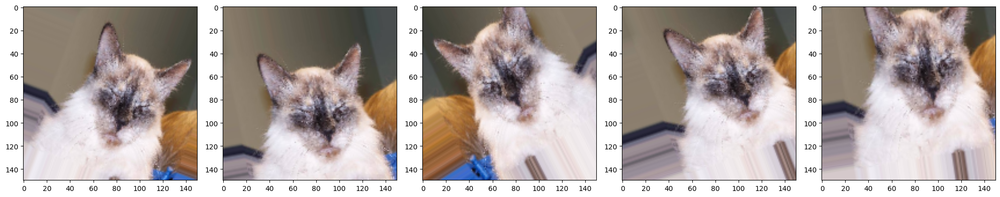

In [29]:
augmented_images = [train_data_gen[0][0][0] for i in range(5)]
plotImages(augmented_images)

### 2.1.5 Creating Validation Data generator

Generally, we only apply data augmentation to our training examples, since the original images should be representative of what our model needs to manage. So, in this case we are only rescaling our validation images and converting them into batches using ImageDataGenerator.

In [30]:
image_gen_val = ImageDataGenerator(rescale=1./255)

val_data_gen = image_gen_val.flow_from_directory(batch_size=BATCH_SIZE,
                                                 directory=validation_dir,
                                                 target_size=(IMG_SHAPE, IMG_SHAPE),
                                                 class_mode='binary')

Found 1000 images belonging to 2 classes.


## 1.4 Model Creation

### 1.4.1 Define the model

The model consists of four convolution blocks with a max pool layer in each of them.

Before the final Dense layers, we're also applying a Dropout probability of 0.5. It means that 50% of the values coming into the Dropout layer will be set to zero. This helps to prevent overfitting.

Then we have a fully connected layer with 512 units, with a `relu` activation function. The model will output class probabilities for two classes — dogs and cats — using `softmax`.

In [31]:
model = tf.keras.models.Sequential([
    tf.keras.layers.InputLayer((150, 150, 3)),
    tf.keras.layers.Conv2D(32, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2, 2),

    tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),

    tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),

    tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),

    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(512, activation='relu'),
    tf.keras.layers.Dense(2, activation='softmax')
])

### 1.4.2 Compiling the model

As usual, we will use the `adam` optimizer. Since we output a softmax categorization, we'll use `sparse_categorical_crossentropy` as the loss function. We would also like to look at training and validation accuracy on each epoch as we train our network, so we are passing in the metrics argument.

In [32]:
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

### 1.4.3 Model Summary

Let's look at all the layers of our network using `summary` method.

In [33]:
model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_4 (Conv2D)                    │ (None, 148, 148, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 74, 74, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 72, 72, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 36, 36, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_6 (Conv2D)                    │ (None, 34, 34, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_4 (MaxPooling2D)       │ (None, 17, 17, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_7 (Conv2D)                    │ (None, 15, 15, 128)         │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_5 (MaxPooling2D)       │ (None, 7, 7, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 7, 7, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 6272)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 512)                 │       3,211,776 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 2)                   │           1,026 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 3,453,634 (13.17 MB)

 Trainable params: 3,453,634 (13.17 MB)

 Non-trainable params: 0 (0.00 B)

### 1.4.4 Train the model

It's time we train our network.

Since our batches are coming from a generator (`ImageDataGenerator`), we'll use `fit_generator` instead of `fit`.

In [34]:
epochs=100
history = model.fit(
    train_data_gen,
    steps_per_epoch=int(np.ceil(total_train / float(BATCH_SIZE))),
    epochs=epochs,
    validation_data=val_data_gen,
    validation_steps=int(np.ceil(total_val / float(BATCH_SIZE)))
)

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 28s 1s/step - accuracy: 0.4933 - loss: 0.7648 - val_accuracy: 0.5070 - val_loss: 0.6897
Epoch 2/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 814ms/step - accuracy: 0.5354 - loss: 0.6929 - val_accuracy: 0.5070 - val_loss: 0.6863
Epoch 3/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 813ms/step - accuracy: 0.5267 - loss: 0.6893 - val_accuracy: 0.6250 - val_loss: 0.6437
Epoch 4/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 814ms/step - accuracy: 0.5991 - loss: 0.6613 - val_accuracy: 0.6320 - val_loss: 0.6434
Epoch 5/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 811ms/step - accuracy: 0.6138 - loss: 0.6599 - val_accuracy: 0.6440 - val_loss: 0.6345
Epoch 6/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 808ms/step - accuracy: 0.5974 - loss: 0.6628 - val_accuracy: 0.5980 - val_loss: 0.6461
Epoch 7/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 807ms/step - accuracy: 0.6092 - loss: 0.6514 - val_accuracy: 0.5790 - val_loss: 0.6705
Epoch 8/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 814ms/step - accuracy: 0.6298 - loss: 0.6407 - val

### 1.4.5 Visualizing results of the training

We'll now visualize the results we get after training our network.

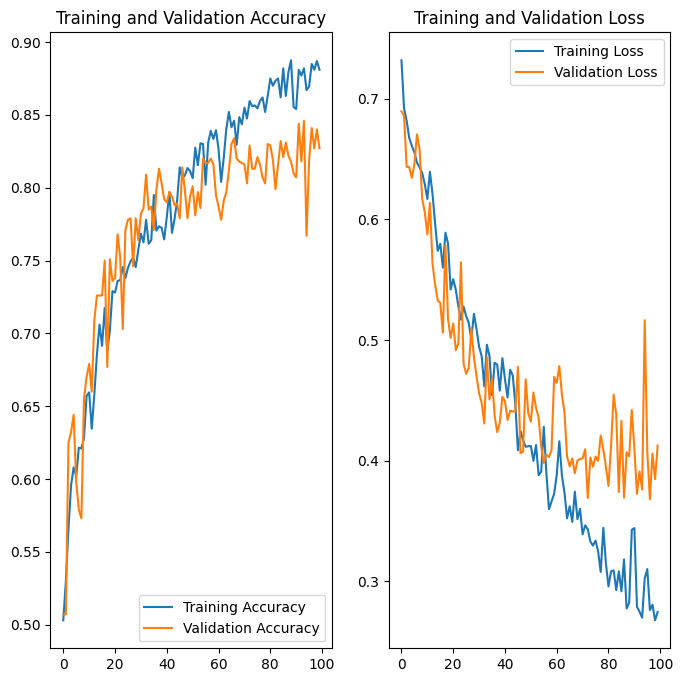

In [35]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

### 1.4.6 Saving the model

In [36]:
model.save('./data/cats_and_dogs_small_1.keras')

# Part 2 - Using a Pretrained ConvNet Model

A common and highly effective approach to deep learning on small image datasets is
to use a pretrained model. A _pretrained model_ is a model that was previously trained on
a large dataset, typically on a large-scale image-classification task. If this original dataset
is large enough and general enough, the spatial hierarchy of features learned by
the pretrained model can effectively act as a generic model of the visual world, and
hence, its features can prove useful for many different computer vision problems,
even though these new problems may involve completely different classes than those
of the original task. For instance, you might train a model on ImageNet (where classes
are mostly animals and everyday objects) and then repurpose this trained model for
something as remote as identifying furniture items in images. Such portability of
learned features across different problems is a key advantage of deep learning compared
to many older, shallow learning approaches, and it makes deep learning very
effective for small-data problems.


In this case, let’s consider a large convnet trained on the ImageNet dataset (1.4
million labeled images and 1'000 different classes). ImageNet contains many animal
classes, including different species of cats and dogs, and you can thus expect it to perform well on the dogs-versus-cats classification problem.

We’ll use the VGG16 architecture, developed by Karen Simonyan and Andrew
Zisserman in 2014. Although it’s an older model, far from the current state of the art
and somewhat heavier than many other recent models, we chose it because its architecture
is similar to what you’re already familiar with, and it’s easy to understand without
introducing any new concepts. This may be your first encounter with one of these
cutesy model names — VGG, ResNet, Inception, Xception, and so on; you’ll get used
to them because they will come up frequently if you keep doing deep learning for
computer vision.



In [37]:
# Import TensorFlow and TensorFlow Datasets
import tensorflow as tf
print(tf.__version__)

# Helper libraries
import math
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.utils import to_categorical

# Defining the loss tensor for filter visualization

model_vgg16 = tf.keras.applications.VGG16(weights='imagenet',
                                   include_top=True)

2.18.0
553467096/553467096 ━━━━━━━━━━━━━━━━━━━━ 24s 0us/step


### 2.1 Instantiating the VGG16 Architecture

In [38]:
model_vgg16 = tf.keras.applications.VGG16(weights='imagenet',
                                   include_top=True)

We pass two arguments to the constructor:

- `weights` specifies the weight checkpoint from which to initialize the model.

- `include_top` refers to including (or not) the densely connected classifier on
top of the network. By default, this densely connected classifier corresponds to
the 1'000 classes from ImageNet. Because we intend to use the entire pretrained VGG16 network, we will include it.

In [39]:
model_vgg16.summary()

Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_3 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ fc1 (Dense)                          │ (None, 4096)                │     102,764,544 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 138,357,544 (527.79 MB)

 Trainable params: 138,357,544 (527.79 MB)

 Non-trainable params: 0 (0.00 B)

### 2.2 Run VGG16 on a single image

Remember our `model_vgg16` object is still the full VGG16 model trained on ImageNet, so it has 1000 possible output classes.
ImageNet has a lot of dogs and cats in it, so let's see if it can predict the images in our Dogs vs. Cats dataset.

Next, we we'll get an input image -- a picture of a cat, not part of the images
the network was trained on.

#### 2.2.1 Preprocessing a single image

In [40]:
import numpy as np
import PIL.Image as Image

# Load cat image from google drive
img_path = tf.keras.utils.get_file(
    fname="cat_1700.jpg",
    origin="https://drive.google.com/uc?id=1XlSuD9_kd8CQGmnPSrtt3ppj-8fcv2nm",
    cache_dir=data_dir,
    cache_subdir=""
)

from tensorflow.keras.preprocessing import image
import numpy as np

def get_img_array(img_path, target_size):
    # Open the image file and resize it
    img = tf.keras.utils.load_img(img_path, target_size=target_size)
    # Turn the image into a float32 NumPy array of shape (224, 224, 3)
    array = tf.keras.utils.img_to_array(img)
    # Add a dimension to transform the array into
    # a “batch” of a single sample.
    # Its shape is now (1, 224, 224, 3).
    array = np.expand_dims(array, axis=0)
    return array


img_tensor_orig = get_img_array(img_path, target_size=(224, 224))

img_tensor =img_tensor_orig/255

print(img_tensor.shape)


145018/145018 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
(1, 224, 224, 3)


#### 2.2.2 Displaying the test picture

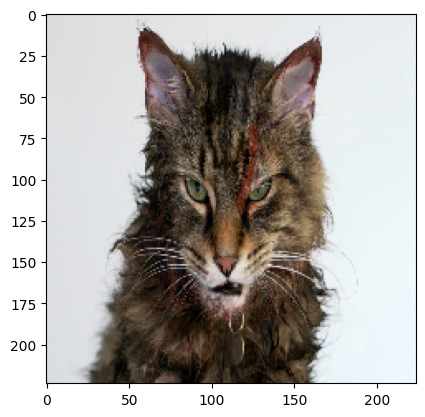

In [41]:
import matplotlib.pyplot as plt

plt.imshow(img_tensor[0])
plt.show()

In [42]:
result = model_vgg16.predict(img_tensor_orig)
result.shape

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


(1, 1000)

The result is a 1001 element vector of logits, rating the probability of each class for the image.

So the top class ID can be found with argmax. But how can we know what class this actually is and in particular if that class ID in the ImageNet dataset denotes a cat or something else?

In [43]:
predicted_class = np.argmax(result[0], axis=-1)
predicted_class

552

#### 2.2.3 Decode the predictions

To see what our `predicted_class` is in the ImageNet dataset, download the ImageNet labels and fetch the row that the model predicted.

35363/35363 ━━━━━━━━━━━━━━━━━━━━ 0s 1us/step
[[('n03325584', 'feather_boa', 0.353683), ('n02123045', 'tabby', 0.2923736), ('n02127052', 'lynx', 0.10941322)]]


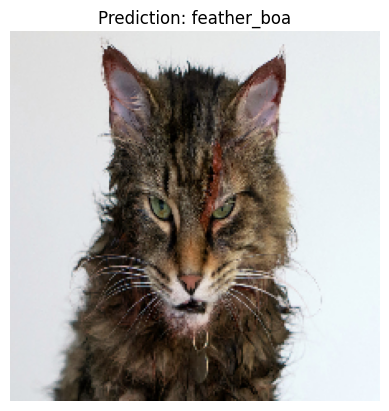

In [44]:
print(tf.keras.applications.vgg16.decode_predictions(result, top=3))

plt.imshow(img_tensor[0])
plt.axis('off')
predicted_class_name = tf.keras.applications.vgg16.decode_predictions(result, top=1)[0][0][1]
_ = plt.title("Prediction: " + predicted_class_name)

That is not correct. Let us see, whether we can do it better with our model we have trained
before.

### 2.3 Running single image with model trained entirely on dog and cat image dataset

#### 2.3.1 Preprocessing a single image

In [45]:
model = tf.keras.models.load_model('./data/cats_and_dogs_small_1.keras', compile = False)
model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_4 (Conv2D)                    │ (None, 148, 148, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 74, 74, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 72, 72, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 36, 36, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_6 (Conv2D)                    │ (None, 34, 34, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_4 (MaxPooling2D)       │ (None, 17, 17, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_7 (Conv2D)                    │ (None, 15, 15, 128)         │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_5 (MaxPooling2D)       │ (None, 7, 7, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 7, 7, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 6272)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 512)                 │       3,211,776 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 2)                   │           1,026 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 3,453,634 (13.17 MB)

 Trainable params: 3,453,634 (13.17 MB)

 Non-trainable params: 0 (0.00 B)

We first need to resize the photo of the cat to the size $150\times 150$.

In [46]:
img_path = './data/cat_1700.jpg'

img_tensor_orig = get_img_array(img_path, target_size=(150, 150))

img_tensor =img_tensor_orig/255

print(img_tensor.shape)

(1, 150, 150, 3)


#### 2.3.2 Decode the predictions

In [47]:
result = model.predict(img_tensor)
print(result)
predicted_class = np.argmax(result[0], axis=-1)
predicted_class

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 515ms/step
[[0.982385   0.01761501]]


0

The subdirectory “cat” comes before “dog“, therefore the class labels are assigned the integers: _cat=0, dog=1_. Thus, the prediction is correct.

# Part 3 - Visualizing what ConvNets Learn


A fundamental problem when building a computer vision application is that of _interpretability_: why did your classifier think a particular image contained a fridge, when all you can see is a truck? This is especially relevant to use cases where deep learning is used to complement human expertise, such as in medical imaging use cases. We will end this chapter by getting you familiar with a range of different techniques for visualizing
what convnets learn and understanding the decisions they make.


It’s often said that deep learning models are “black boxes”: they learn representations
that are difficult to extract and present in a human-readable form. Although this
is partially true for certain types of deep learning models, it’s definitely not true for convnets. The representations learned by convnets are highly amenable to visualization, in large part because they’re _representations of visual concepts_. Since 2013, a wide array of techniques has been developed for visualizing and interpreting these representations. We won’t survey all of them, but we’ll cover three of the most accessible
and useful ones:

- _Visualizing intermediate ConvNet outputs (intermediate activations)_ -- Useful for understanding how successive convnet layers transform their input, and for getting a first idea of the meaning of individual ConvNet filters.

- _Visualizing ConvNet filters_ -- Useful for understanding precisely what visual pattern or concept each filter in a convnet is receptive to.

- _Visualizing heatmaps of class activation in an image_ -- Useful for understanding which parts of an image were identified as belonging to a given class, thus allowing you to localize objects in images.

For the first method - activation visualization - we will use the small ConvNet that we have trained from scratch on the dogs-versus-cats classification problem before. For the last method, we’ll use a pretrained Xception model.

## 3.1 Visualizing Intermediate Layers


Visualizing intermediate activations consists of displaying the values returned by various convolution and pooling layers in a model, given a certain input (the output of a layer is often called its __activation__, the output of the activation function).

This gives a view into how an input is decomposed into the different filters learned by the network. We want to visualize feature maps with three dimensions: width, height, and depth (number of filters = number of activation maps).
Each filter encodes relatively independent features, so the proper way to visualize
these feature maps is by independently plotting the contents of every activation map as a 2D image. Let’s start by loading the model that we trained on the cats-vs-dogs dataset.

In [48]:
# Import TensorFlow and TensorFlow Datasets
import tensorflow as tf
print(tf.__version__)

# Helper libraries
import math
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.utils import to_categorical

model = tf.keras.models.load_model('./data/cats_and_dogs_small_1.keras')
model.summary()

2.18.0


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_4 (Conv2D)                    │ (None, 148, 148, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 74, 74, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 72, 72, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 36, 36, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_6 (Conv2D)                    │ (None, 34, 34, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_4 (MaxPooling2D)       │ (None, 17, 17, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_7 (Conv2D)                    │ (None, 15, 15, 128)         │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_5 (MaxPooling2D)       │ (None, 7, 7, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 7, 7, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 6272)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 512)                 │       3,211,776 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 2)                   │           1,026 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 10,360,904 (39.52 MB)

 Trainable params: 3,453,634 (13.17 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 6,907,270 (26.35 MB)

Next, we we'll get an input image -- a picture of a cat, not part of the images
the network was trained on.

In [49]:
from tensorflow import keras
import numpy as np

# Download a test image
img_path = keras.utils.get_file(fname="cat.jpg", origin="https://img-datasets.s3.amazonaws.com/cat.jpg")
# Alternatively, use the following one
#img_path = './Daten/cat_1700.jpg'

def get_img_array(img_path, target_size):
    # Open the image file and resize it.
    img = keras.utils.load_img(img_path, target_size=target_size)
    # Turn the image into a float32 NumPy array of shape (150, 150, 3)
    array = keras.utils.img_to_array(img)
    # Add a dimension to transform the array into
    # a “batch” of a single sample. Its shape is now
    # (1, 150, 150, 3)
    array = np.expand_dims(array, axis=0)
    return array


img_tensor = get_img_array(img_path, target_size=(150, 150))


print(img_tensor.shape)

80329/80329 ━━━━━━━━━━━━━━━━━━━━ 0s 5us/step
(1, 150, 150, 3)


#### Displaying the test picture

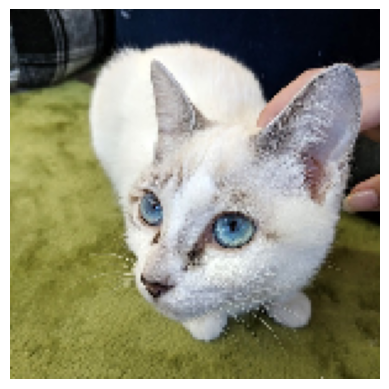

In [50]:
import matplotlib.pyplot as plt
plt.axis("off")
plt.imshow(img_tensor[0].astype("uint8"))
plt.show()

In order to extract the activation maps we want to look at, we’ll create a Keras model that takes batches of images as input, and that outputs the activations of all convolution and pooling layers.

#### Instantiating a model that returns layer activations

In [51]:
from tensorflow.keras import layers
layer_outputs = []
layer_names = []
for layer in model.layers:
    # Extract the outputs of all Conv2D and MaxPooling2D layers and put them in a list.
    if isinstance(layer, (layers.Conv2D, layers.MaxPooling2D)):
        layer_outputs.append(layer.output)
        # Save the layer names for later
        layer_names.append(layer.name)
# Create a model that will return these outputs, given the model input.
activation_model = tf.keras.Model(inputs=model.layers[0].input, outputs=layer_outputs)

When fed an image input, this model returns the values of the layer activations in the
original model, as a list. This is a multi-output model. Until now,
the models we’ve seen have had exactly one input and one output. This one has one
input and eight outputs: one output per layer activation.

#### Using the model to compute layer activations

In [52]:
# Return a list of nine NumPy arrays: one array per layer activation.
activations = activation_model.predict(img_tensor)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 700ms/step


For instance, this is the activation of the first convolution layer for the cat image input:

In [53]:
first_layer_activation = activations[0]
print(first_layer_activation.shape)

(1, 148, 148, 32)


It’s a $148\times 148$ feature map with 32 channels. Let’s try plotting the fifth channel of the activation of the first layer of the original model

#### Visualizing the fifth channel

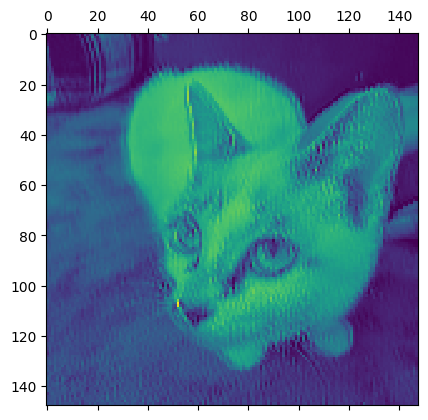

In [54]:
import matplotlib.pyplot as plt
plt.matshow(first_layer_activation[0, :, :, 5], cmap="viridis")

This channel appears to encode a diagonal edge detector—but note that your own
channels may vary, because the specific filters learned by convolution layers aren’t
deterministic.
Now, let’s plot a complete visualization of all the activations in the network. We’ll extract and plot every channel in each of the layer activations, and
we’ll stack the results in one big grid, with channels stacked side by side.

#### Visualizing every channel in every intermediate activation

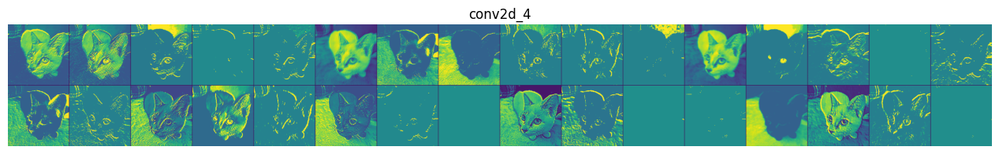

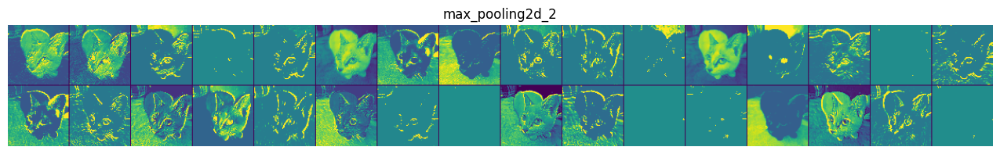

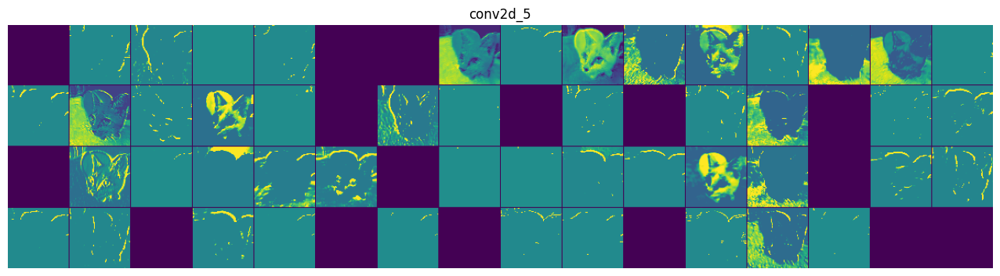

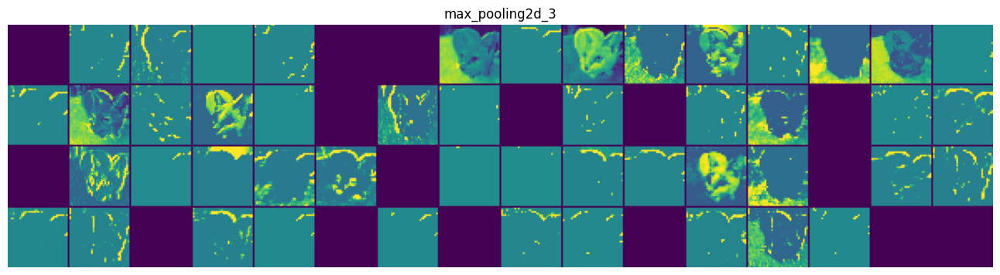

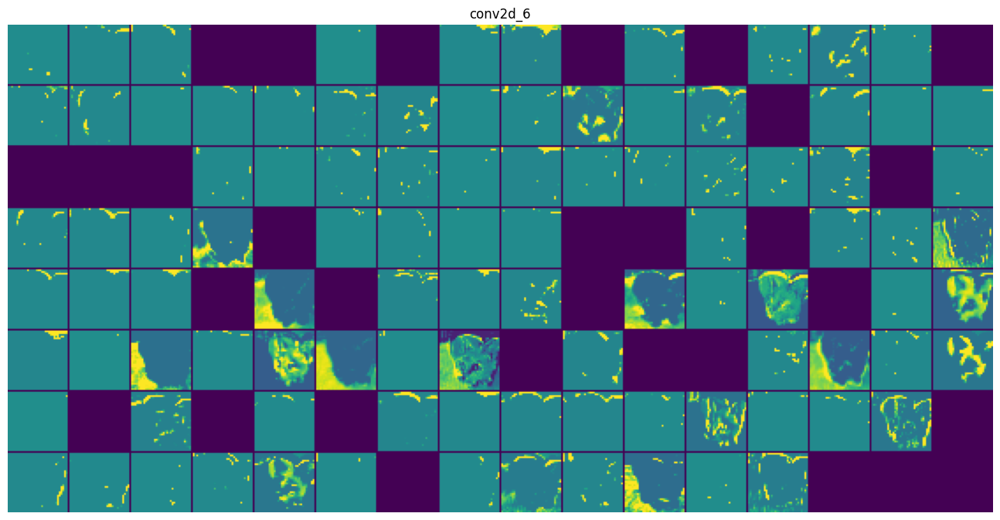

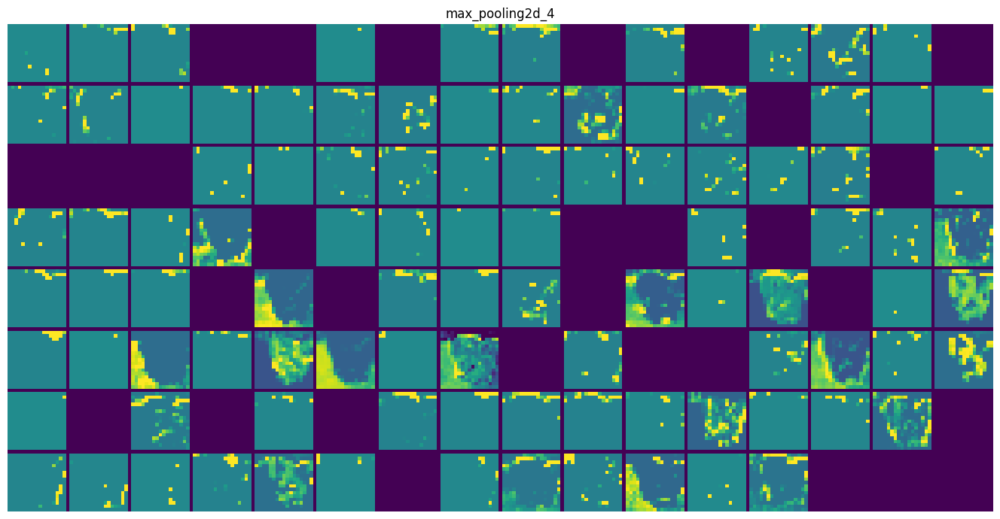

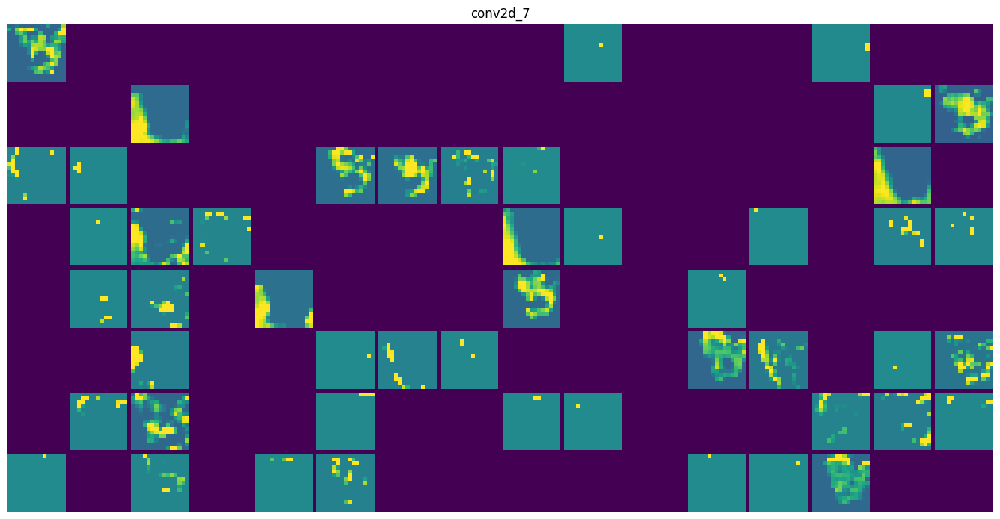

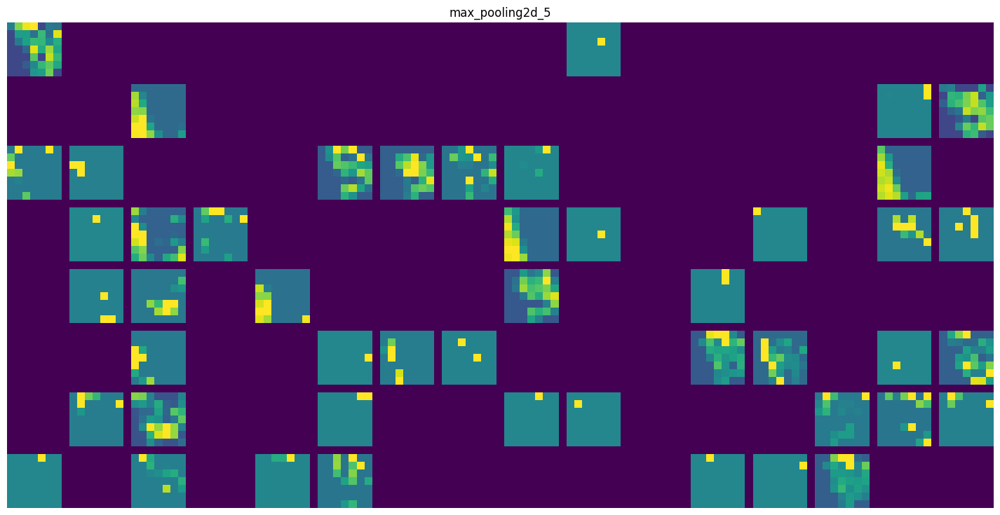

In [55]:
images_per_row = 16
# Iterate over the activations (and the names of the corresponding layers)
for layer_name, layer_activation in zip(layer_names, activations):
    # The layer activation has shape (1, size, size, n_features)
    n_features = layer_activation.shape[-1]
    size = layer_activation.shape[1]
    n_cols = n_features // images_per_row
    # Prepare an empty grid for displaying all the channels in this activation.
    display_grid = np.zeros(((size + 1) * n_cols - 1, images_per_row * (size + 1) - 1))
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_index = col * images_per_row + row
            # This is a single channel (or feature)
            channel_image = layer_activation[0, :, :, channel_index].copy()
            # Normalize channel values within the [0, 255] range. Allzero
            # channels are kept at zero.
            if channel_image.sum() != 0:
                channel_image -= channel_image.mean()
                channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype("uint8")
            # Place the channel matrix in the empty grid we prepared.
            display_grid[col * (size + 1): (col + 1) * size + col, row * (size + 1) : (row + 1) * size + row] = channel_image

    # Display the grid for the layer.
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.axis("off")
    plt.imshow(display_grid, aspect="auto", cmap="viridis")

There are a few things to note here:

- The first layer acts as a collection of various edge detectors. At that stage, the
  activations retain almost all of the information present in the initial picture.

- As you go deeper, the activations become increasingly abstract and less visually
  interpretable. They begin to encode higher-level concepts such as “cat ear” and
  “cat eye.” Deeper presentations carry increasingly less information about the
  visual contents of the image, and increasingly more information related to the
  class of the image.

- The sparsity of the activations increases with the depth of the layer: in the first
  layer, almost all filters are activated by the input image, but in the following   
  layers, more and more filters are blank. This means the pattern encoded by the filter
  isn’t found in the input image.


We have just evidenced an important universal characteristic of the representations
learned by deep neural networks: the features extracted by a layer become increasingly
abstract with the depth of the layer. The activations of higher layers carry less
and less information about the specific input being seen, and more and more information about the target (in this case, the class of the image: cat or dog). A deep neural network effectively acts as an information distillation pipeline, with raw data going in (in this case, RGB pictures) and being repeatedly transformed so that irrelevant information is filtered out (for example, the specific visual appearance of the image), and useful information is magnified and refined (for example, the class of the image).

This is analogous to the way humans and animals perceive the world: after observing
a scene for a few seconds, a human can remember which abstract objects were
present in it (bicycle, tree) but can’t remember the specific appearance of these
objects. In fact, if you tried to draw a generic bicycle from memory, chances are you
couldn’t get it even remotely right, even though you’ve seen thousands of bicycles in
your lifetime. Try it right now: this effect is absolutely real. Your brain has learned to completely abstract its visual input—to transform it into high-level visual concepts while filtering out irrelevant visual details—making it tremendously difficult to remember how things around you look.

## 3.2 Visualizing Convnet Filters

We can access all of the layers of the model via the `model.layers` property.

Each layer has a `layer.name` property, where the convolutional layers have a naming convolution like `block#_conv#`, where the `#` is an integer. Therefore, we can check the name of each layer and skip any that don’t contain the string `conv`.

In [56]:
# summarize filter shapes
for layer in model.layers:
    # check for convolutional layer
    if 'conv' not in layer.name:
        continue

Each convolutional layer has two sets of weights. One is the block of filters and the other is the block of bias values. These are accessible via the `layer.get_weights()` function. We can retrieve these weights and then summarize their shape.

In [57]:
# get filter weights
filters, biases = layer.get_weights()
print(layer.name, filters.shape)

dense_3 (512, 2)


Tying this together, the complete example of summarizing the model filters is listed below.

In [58]:
# summarize filters in each convolutional layer
import matplotlib.pyplot as plt
# load the model

# summarize filter shapes
for layer in model.layers:
    # check for convolutional layer
    if 'conv' not in layer.name:
        continue
    # get filter weights
    filters, biases = layer.get_weights()
    print(layer.name, filters.shape)

conv2d_4 (3, 3, 3, 32)
conv2d_5 (3, 3, 32, 64)
conv2d_6 (3, 3, 64, 128)
conv2d_7 (3, 3, 128, 128)


We can see that all convolutional layers use 3×3 filters, which are small and perhaps easy to interpret.

We can retrieve the filters from the first layer as follows:

In [59]:
# retrieve weights from the first hidden layer
filters, biases = model.layers[0].get_weights()
print(filters.shape, biases.shape, filters.dtype)

(3, 3, 3, 32) (32,) float32


In [60]:
# normalize filter values to 0-1 so we can visualize them
f_min, f_max = filters.min(), filters.max()
filters = (filters - f_min) / (f_max - f_min)

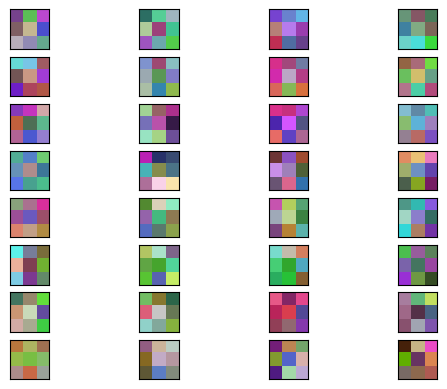

In [61]:
# plot all 32 filters
n_filters = 32
for i in range(n_filters):
    # get the filter
    f = filters[:, :, :, i]
    ax = plt.subplot(8, 4 , i+1)
    ax.set_xticks([])
    ax.set_yticks([])
    plt.imshow(f)
# show the figure
plt.show()

We can see that for the input image with three channels for red, green and blue, that each filter has a depth of three (here we are working with a channel-last format). We could visualize one filter as a plot with three images, one for each channel, or compress all three down to a single color image, or even just look at the first channel and assume the other channels will look the same. The problem is, we then have 63 other filters that we might like to visualize.


Now we can enumerate the first six filters out of the 32 in the block and plot each of the three channels of each filter.

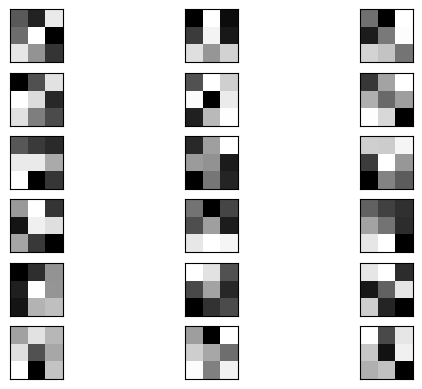

In [62]:
# plot first few filters
n_filters, ix = 6, 1
for i in range(n_filters):
    # get the filter
    f = filters[:, :, :, i]
    # plot each channel separately
    for j in range(3):
        # specify subplot and turn of axis
        ax = plt.subplot(n_filters, 3, ix)
        ax.set_xticks([])
        ax.set_yticks([])
        # plot filter channel in grayscale
        plt.imshow(f[:, :, j], cmap='gray')
        ix += 1
# show the figure
plt.show()

## 3.3 Visualizing heatmaps of class activation in an image

We’ll introduce one last visualization technique — one that is useful for understanding
which parts of a given image led a convnet to its final classification decision. This is
helpful for “debugging” the decision process of a convnet, particularly in the case of a
classification mistake (a problem domain called _model interpretability_). It can also allow you to locate specific objects in an image.

This general category of techniques is called _class activation map_ (CAM) visualization,
and it consists of producing heatmaps of class activation over input images. A class activation heatmap is a 2D grid of scores associated with a specific output class,
computed for every location in any input image, indicating how important each location
is with respect to the class under consideration. For instance, given an image fed
into a dogs-versus-cats convnet, CAM visualization would allow you to generate a heatmap
for the class “cat,” indicating how cat-like different parts of the image are, and
also a heatmap for the class “dog,” indicating how dog-like parts of the image are.
The specific implementation we’ll use is the one described in an article titled “Grad-
CAM: Visual Explanations from Deep Networks via Gradient-based Localization.”

Grad-CAM consists of taking the output volume of a convolution layer, given
an input image, and weighting every activation map by the gradient of
the class with respect to the activation map. Intuitively, one way to understand this trick is to imagine that you’re weighting an activation map of “how intensely the input image activates this activation map” by “how important each activation map is with regard to the class,” resulting in a spatial map of “how intensely the input image activates the class.”

Let’s demonstrate this technique using the pretrained Xception model.

#### Loading the Xception network with pretrained weights

In [63]:
# Note that we include the densely connected classifier on top
model = keras.applications.xception.Xception(weights="imagenet")

91884032/91884032 ━━━━━━━━━━━━━━━━━━━━ 5s 0us/step


Consider the image of two African elephants shown in the figure below, possibly a mother
and her calf, strolling on the savanna. Let’s convert this image into something the Xception model can read: the model was trained on images of size $299\times 299$, preprocessed according to a few rules that are packaged in the `keras.applications.xception.preprocess_input` utility function. So we need to load the image, resize it to $299\times 299$, convert it to a NumPy float32 tensor, and apply these preprocessing rules.

#### Preprocessing an input image for Xception

In [64]:
# Download the image and store it locally under the path img_path
img_path = keras.utils.get_file(fname="elephant.jpg", origin="https://img-datasets.s3.amazonaws.com/elephant.jpg")
img_path = keras.utils.get_file(fname="elephant_1.jpg", origin="https://warnercnr.source.colostate.edu/wp-content/uploads/sites/9/2024/11/Elephant-decline-square.jpg")
def get_img_array(img_path, target_size):
    # Return a Python Imaging Library (PIL) image of size 299   299
    img = keras.utils.load_img(img_path, target_size=target_size)
    # Return a float32 NumPy array of shape (299, 299, 3)
    array = keras.utils.img_to_array(img)
    # Add a dimension to transform the array into a batch of size (1, 299, 299, 3)
    array = np.expand_dims(array, axis=0)
    # Preprocess the batch (this does channel-wise color normalization).
    array = keras.applications.xception.preprocess_input(array)
    return array
img_array = get_img_array(img_path, target_size=(299, 299))
print(img_path)

733657/733657 ━━━━━━━━━━━━━━━━━━━━ 1s 1us/step
845978/845978 ━━━━━━━━━━━━━━━━━━━━ 1s 1us/step
/root/.keras/datasets/elephant_1.jpg


We can now run the pretrained network on the image and decode its prediction vector
back to a human-readable format:

In [65]:
preds = model.predict(img_array)

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


In [66]:
print(keras.applications.xception.decode_predictions(preds, top=3)[0])

[('n02504458', 'African_elephant', 0.8135849), ('n01871265', 'tusker', 0.07449876), ('n02504013', 'Indian_elephant', 0.02298634)]


The top three classes predicted for this image are as follows:

 - _African elephant_ (with 87% probability)

 - _Tusker_ (with 7% probability)

 - _Indian elephant_ (with 2% probability)

The network has recognized the image as containing an undetermined quantity of
African elephants. The entry in the prediction vector that was maximally activated is
the one corresponding to the “African elephant” class, at index 386:

In [67]:
np.argmax(preds[0])

386

To visualize which parts of the image are the most African-elephant–like, let’s set up
the Grad-CAM process. First, we create a model that maps the input image to the activations of the last convolutional layer.

#### Setting up a model that returns the last convolutional output

In [68]:
last_conv_layer_name = "block14_sepconv2_act"
classifier_layer_names = ["avg_pool", "predictions",]
last_conv_layer = model.get_layer(last_conv_layer_name)
last_conv_layer_model = keras.Model(model.inputs, last_conv_layer.output)

Second, we create a model that maps the activations of the last convolutional layer to
the final class predictions.

#### Reapplying the classifier on top of the last convolutional output

In [69]:
classifier_input = keras.Input(shape=last_conv_layer.output.shape[1:])
x = classifier_input
for layer_name in classifier_layer_names:
    x = model.get_layer(layer_name)(x)
classifier_model = keras.Model(classifier_input, x)

Then we compute the gradient of the top predicted class for our input image with
respect to the activations of the last convolution layer.

#### Retrieving the gradients of the top predicted class

In [70]:
import tensorflow as tf
with tf.GradientTape() as tape:
    # Compute activations of the last conv layer and make the tape watch it
    last_conv_layer_output = last_conv_layer_model(img_array)
    tape.watch(last_conv_layer_output)
    # Retrieve the activation map corresponding to the top predicted class
    preds = classifier_model(last_conv_layer_output)
    top_pred_index = tf.argmax(preds[0])
    top_class_channel = preds[:, top_pred_index]
# This is the gradient of the top predicted class with regard
# to the output feature map of the last convolutional layer
grads = tape.gradient(top_class_channel, last_conv_layer_output)

/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor_516']
Received: inputs=Tensor(shape=(1, 299, 299, 3))
  warnings.warn(msg)


Now we apply pooling and importance weighting to the gradient tensor to obtain our
heatmap of class activation.

#### Gradient pooling and channel-importance weighting

In [71]:
# This is a vector where each entry is the mean intensity of the
# gradient for a given channel. It quantifies the importance of
# each channel with regard to the top predicted class
pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2)).numpy()
last_conv_layer_output = last_conv_layer_output.numpy()[0]
for i in range(pooled_grads.shape[-1]):
    # Multiply each channel in the output of the last
    # convolutional layer by “how important this activation map is"
    last_conv_layer_output[:, :, i] *= pooled_grads[i]
# The channel-wise mean of the resulting feature
# map is our heatmap of class activation.
heatmap = np.mean(last_conv_layer_output, axis=-1)

For visualization purposes, we’ll also normalize the heatmap between 0 and 1.

#### Heatmap post-processing

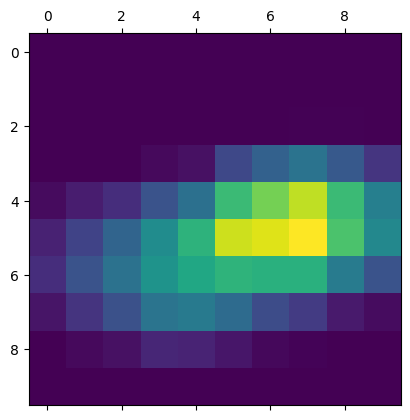

In [72]:
heatmap = np.maximum(heatmap, 0)
heatmap /= np.max(heatmap)
plt.matshow(heatmap)

Finally, let’s generate an image that superimposes the original image on the heatmap
we just obtained

#### Superimposing the heatmap on the original picture

In [73]:
import matplotlib.cm as cm
# Load the original image.
img = keras.utils.load_img(img_path)
img = keras.utils.img_to_array(img)

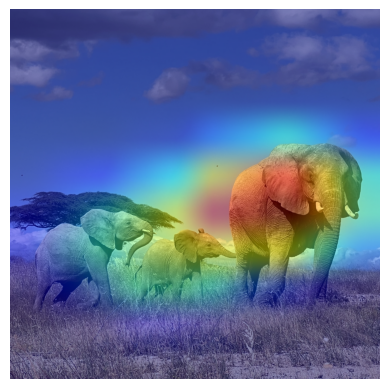

In [74]:
import matplotlib.pyplot as plt

# Rescale the heatmap to the range 0–255
heatmap = np.uint8(255 * heatmap)

# Use the "jet" colormap to recolorize the heatmap
jet = plt.get_cmap("jet")
jet_colors = jet(np.arange(256))[:, :3]

# Create an image that contains the recolorized heatmap
jet_heatmap = jet_colors[heatmap]
jet_heatmap = keras.utils.array_to_img(jet_heatmap)
jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
jet_heatmap = keras.utils.img_to_array(jet_heatmap)

# Superimpose the heatmap and the original image,
# with the heatmap at 80% opacity.
superimposed_img = jet_heatmap * 0.8 + img
superimposed_img = keras.utils.array_to_img(superimposed_img)

# Display the image in Colab
plt.imshow(superimposed_img)
plt.axis('off')  # Hide the axes
plt.show()


This visualization technique answers two important questions:

 - Why did the network think this image contained an African elephant?

 - Where is the African elephant located in the picture?

In particular, it’s interesting to note that the ears of the elephant calf are strongly activated:
this is probably how the network can tell the difference between African and
Indian elephants.

# Part 4 : Transfer Learning


Having to train an image-classification model using very little data is a common situation,
which you’ll likely encounter in practice if you ever do computer vision in a
professional context. A “few” samples can mean anywhere from a few hundred to a
few tens of thousands of images. As a practical example, we’ll focus on classifying
560 images belongig to 8 actors. We’ll use 480 pictures for training, and 80 for validation.

## 4.1 Feature Extraction with a Pretrained Model

Feature extraction consists of using the representations learned by a previously
trained model to extract interesting features from new samples. These features are
then run through a new classifier, which is trained from scratch.


As you saw previously, ConvNets used for image classification comprise two parts:
they start with a series of pooling and convolution layers, and they end with a densely
connected classifier. The first part is called the _convolutional base_ of the model. In the
case of convnets, feature extraction consists of taking the convolutional base of a previously
trained network, running the new data through it, and training a new classifier
on top of the output.






In [75]:
# General imports
import tensorflow as tf
tf.compat.v1.enable_eager_execution(
    config=None, device_policy=None, execution_mode=None
)
import numpy as np
import matplotlib.pyplot as plt
import os, datetime

# Shortcuts to keras if (however from tensorflow)
from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D
from tensorflow.keras.layers import Activation, Dropout, Flatten, Dense
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras import layers

<img src = 'https://drive.google.com/uc?id=1AoTHdbl58NtKCdsz9dupVb-maul28jiK' width = 800>

Why only reuse the convolutional base? Could we reuse the densely connected
classifier as well? In general, doing so should be avoided. The reason is that the representations
learned by the convolutional base are likely to be more generic and, therefore,
more reusable: the feature maps of a ConvNet are presence maps of generic
concepts over a picture, which are likely to be useful regardless of the computer vision
problem at hand. But the representations learned by the classifier will necessarily be
specific to the set of classes on which the model was trained—they will only contain
information about the presence probability of this or that class in the entire picture.
Additionally, representations found in densely connected layers no longer contain any information about where objects are located in the input image; these layers get rid of
the notion of space, whereas the object location is still described by convolutional feature
maps. For problems where object location matters, densely connected features
are largely useless.


Note that the level of generality (and therefore reusability) of the representations
extracted by specific convolution layers depends on the depth of the layer in the
model. Layers that come earlier in the model extract local, highly generic feature
maps (such as visual edges, colors, and textures), whereas layers that are higher up
extract more-abstract concepts (such as “cat ear” or “dog eye”). So if your new dataset
differs a lot from the dataset on which the original model was trained, you may be better
off using only the first few layers of the model to do feature extraction, rather than
using the entire convolutional base.



In this case, because the ImageNet class set does not contain images of actors, we’ll
choose not to use the densely connected layers, in order to cover
the more general case where the class set of the new problem doesn’t overlap the
class set of the original model. Let’s put this into practice by using the convolutional
base of the VGG16 network, trained on ImageNet, to extract interesting features
from actors, and then train a classifier for the 8 actors on top of
these features.

The VGG16 model, among others, comes prepackaged with Keras. You can import
it from the `keras.applications` module. Many other image-classification models (all
pretrained on the ImageNet dataset) are available as part of `keras.applications`:


- Xception
- ResNet
- MobileNet
- EfficientNet
- DenseNet
- etc.

Let's instantiate the VGG16 model.

In [76]:
# The target image size can be fixed here (quadratic)
# The ImageDataGenerator() automatically scales the images accordingly (aspect ratio is changed)
image_size = 150

In [77]:
conv_base = keras.applications.vgg16.VGG16(weights="imagenet",
                                           include_top=False,
                                           input_shape=(image_size, image_size, 3))

58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 4s 0us/step


You pass three arguments to the constructor:

- `weights` specifies the weight checkpoint from which to initialize the model.

- `include_top` refers to including (or not) the densely connected classifier on
top of the network. By default, this densely connected classifier corresponds to
the 1'000 classes from ImageNet. Because we intend to use our own densely
connected classifier (with 8 classes of actors), we don’t need to
include it.

- `input_shape` is the shape of the image tensors that we’ll feed to the network.
This argument is purely optional: if we don’t pass it, the network will be able to
process inputs of any size. Here we pass it so that we can visualize (in the following
summary) how the size of the feature maps shrinks with each new convolution
and pooling layer.

Here’s the detail of the architecture of the VGG16 convolutional base. It’s similar to
the simple convnets you’re already familiar with:

In [78]:
conv_base.summary()

Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_6 (InputLayer)           │ (None, 150, 150, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 150, 150, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 150, 150, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 75, 75, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 75, 75, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 75, 75, 128)         │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 37, 37, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 37, 37, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 37, 37, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 37, 37, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 18, 18, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 18, 18, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 18, 18, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 18, 18, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 9, 9, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 9, 9, 512)           │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 9, 9, 512)           │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 9, 9, 512)           │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 4, 4, 512)           │               0 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 14,714,688 (56.13 MB)

 Non-trainable params: 0 (0.00 B)


The final feature map (output volume) has shape $(4, 4, 512)$. That's the feature on top of which we will stick a densely connected classifier.

At this point, there are two ways how we could proceed:

- __Approach 1__: Run the convolutional base over our dataset, record its output to a NumPy array
on disk, and then use this data as input to a standalone, densely connected classifier
similar to those you saw in Block 4 of this course. This solution is fast and
cheap to run, because it only requires running the convolutional base once for
every input image, and the convolutional base is by far the most expensive part
of the pipeline. But for the same reason, this technique won’t allow us to use
data augmentation.

- __Approach 2__: Extend the model we have (`conv_base`) by adding `Dense` layers on top, and run
the whole thing from end to end on the input data. This will allow us to use
data augmentation, because every input image goes through the convolutional
base every time it’s seen by the model. But for the same reason, this technique is
far more expensive than the first.

We’ll cover both techniques. Let’s walk through the code required to set up the first
one: recording the output of `conv_base` on our data and using these outputs as inputs
to a new model.

### 1. Approach : Fast feature extraction without data augmentation


We’ll start by extracting features as NumPy arrays by calling the `predict()` method of
the `conv_base` model on our training, and validation datasets.
Let’s iterate over our datasets to extract the VGG16 features.

In [79]:
!rm -rf content

In [80]:
import gdown
import zipfile

zip_file_url = 'https://drive.google.com/uc?id=13S_kxVY44SNC9X2aUo9XHoqu6lMmKVHJ&export=download'
output = '/content/data/celebrities.zip'

if not os.path.exists('/content/data'):
    os.makedirs('/content/data')

# Download the zip file
gdown.download(zip_file_url, output, quiet=False)


# Unzip the downloaded file
with zipfile.ZipFile(output, 'r') as zip_ref:
    zip_ref.extractall('/content/data/')

# Check the contents
import os
print(os.listdir('/content/data/celebrities'))

training_directory = '/content/data/celebrities/train'
validation_directory = '/content/data/celebrities/validation'

class_names = ["angelina jolie", "brad pitt","catherine deneuve" , "johnny depp","leonardo dicaprio", "marion cotillard", "robert de niro","sandra bullock"]

Downloading...
From (original): https://drive.google.com/uc?id=13S_kxVY44SNC9X2aUo9XHoqu6lMmKVHJ&export=download
From (redirected): https://drive.google.com/uc?id=13S_kxVY44SNC9X2aUo9XHoqu6lMmKVHJ&export=download&confirm=t&uuid=0b942cd6-c4f1-42f0-8f48-d65409ff128a
To: /content/data/celebrities.zip
100%|██████████| 39.5M/39.5M [00:01<00:00, 24.1MB/s]


['train', 'validation']


In [81]:
from tensorflow.keras.utils import image_dataset_from_directory

train_dataset = image_dataset_from_directory(
    training_directory,
    image_size=(150, 150),
    batch_size=32,
    shuffle=False,
    label_mode="categorical")

validation_dataset = image_dataset_from_directory(
    validation_directory,
    image_size=(150, 150),
    batch_size=32,
    shuffle=False,
    label_mode="categorical")

Found 480 files belonging to 8 classes.
Found 80 files belonging to 8 classes.


In [82]:
import numpy as np
def get_features_and_labels(dataset):
    all_features = []
    all_labels = []
    for images, labels in dataset:
        preprocessed_images = keras.applications.vgg16.preprocess_input(images)
        features = conv_base.predict(preprocessed_images)
        all_features.append(features)
        all_labels.append(labels)
    return np.concatenate(all_features), np.concatenate(all_labels)

train_features, train_labels = get_features_and_labels(train_dataset)
val_features, val_labels = get_features_and_labels(validation_dataset)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


Importantly, `predict()` only expects images, not labels, but our current dataset yields
batches that contain both images and their labels. Moreover, the VGG16 model expects
inputs that are preprocessed with the function `keras.applications.vgg16.preprocess_input`, which scales pixel values to an appropriate range.
The extracted features are currently of shape `(samples, 4, 4, 512)`:

In [83]:
train_features.shape

(480, 4, 4, 512)

And the labels are now referring to the order of the folders

In [84]:
train_labels.shape

(480, 8)

In [85]:
print(val_features.shape)
print(val_labels.shape)

(80, 4, 4, 512)
(80, 8)


In [86]:
inputs = keras.Input(shape=(4, 4, 512))
# Note the use of the Flatten layer before passing the
# features to a Dense layer
x = layers.Flatten()(inputs)
x = layers.Dense(256)(x)
x = layers.Dropout(0.7)(x)
outputs = layers.Dense(8, activation="softmax")(x)
model = keras.Model(inputs, outputs)

In [87]:
model.summary()

Model: "functional_52"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_7 (InputLayer)           │ (None, 4, 4, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_2 (Flatten)                  │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 256)                 │       2,097,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_4 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 8)                   │           2,056 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 2,099,464 (8.01 MB)

 Trainable params: 2,099,464 (8.01 MB)

 Non-trainable params: 0 (0.00 B)

In [88]:
model.compile(loss="categorical_crossentropy",
    optimizer="rmsprop",
    metrics=["accuracy"])


logdir = os.path.join("logs_feature_extraction", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))


callbacks = [
    keras.callbacks.ModelCheckpoint(filepath="data/celebrities/feature_extraction.keras", save_best_only=True, monitor="val_loss"),
    tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)
]

history = model.fit(
train_features, train_labels,
epochs=30,
validation_data=(val_features, val_labels),
callbacks=callbacks
)

Epoch 1/30
15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 136ms/step - accuracy: 0.2398 - loss: 53.0637 - val_accuracy: 0.4375 - val_loss: 16.3063
Epoch 2/30
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.5993 - loss: 15.5259 - val_accuracy: 0.4000 - val_loss: 20.8896
Epoch 3/30
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.7595 - loss: 7.1764 - val_accuracy: 0.4875 - val_loss: 19.4489
Epoch 4/30
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.7785 - loss: 7.0233 - val_accuracy: 0.4625 - val_loss: 19.6513
Epoch 5/30
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.7976 - loss: 5.3399 - val_accuracy: 0.5125 - val_loss: 19.5004
Epoch 6/30
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.8420 - loss: 4.2249 - val_accuracy: 0.5125 - val_loss: 24.7065
Epoch 7/30
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.8339 - loss: 4.4101 - val_accuracy: 0.4500 - val_loss: 25.7638
Epoch 8/30
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.8891 - loss: 4.1027 - val_accuracy: 

Note that we’ll also use a `ModelCheckpoint` callback to save the model after each
epoch. We’ll configure it with the path specifying where to save the file, as well as the
arguments `save_best_only=True` and `monitor="val_loss"`: they tell the callback to
only save a new file (overwriting any previous one) when the current value of the
`val_loss` metric is lower than at any previous time during training. This guarantees
that your saved file will always contain the state of the model corresponding to its bestperforming
training epoch, in terms of its performance on the validation data. As a
result, we won’t have to retrain a new model for a lower number of epochs if we start
overfitting: we can just reload our saved file.

Let’s look at the loss and accuracy curves during training:

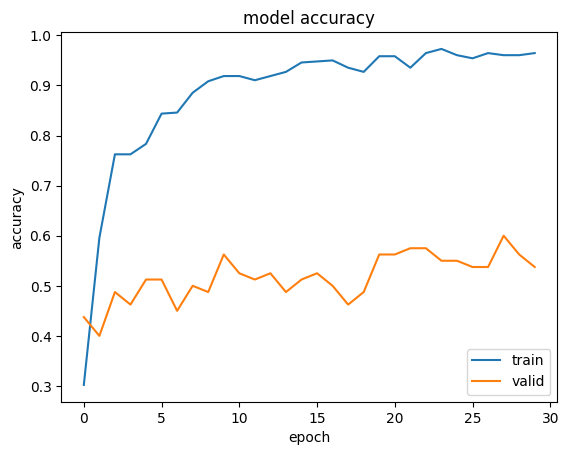

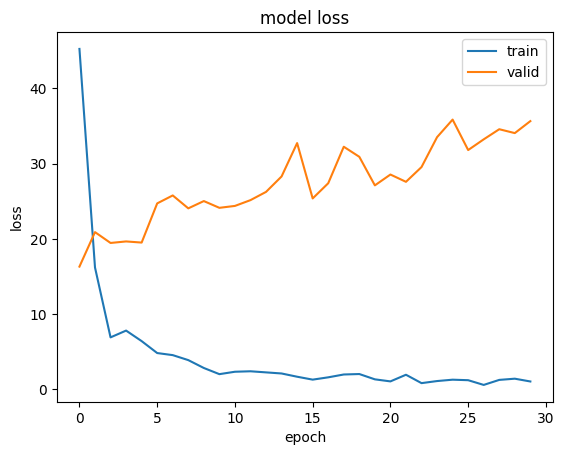

In [89]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'valid'], loc='lower right')
plt.show()
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'valid'], loc='upper right')
plt.show()

In [90]:
model.evaluate(val_features, val_labels)

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - accuracy: 0.5148 - loss: 36.4278


[35.64076614379883, 0.5375000238418579]

We reach a validation accuracy of about 52% — much worse than we achieved in the
previous section with the small model trained from scratch.

The learning curves indicate that we’re overfitting almost from the start—
despite using dropout with a fairly large rate. That’s because this technique doesn’t
use data augmentation, which is essential for preventing overfitting with small image
datasets.

#### Tensorboard

In [91]:
# Load the TensorBoard notebook extension on google colab
%load_ext tensorboard

%tensorboard --logdir logs

Output hidden; open in https://colab.research.google.com to view.

### 2. Approach : Feature Extraction with Data Augmentation


Now let’s review the second technique we mentioned for doing feature extraction,
which is much slower and more expensive, but which allows us to use data augmentation
during training: creating a model that chains the `conv_base` with a new dense
classifier, and training it end to end on the inputs.


In order to do this, we will first freeze the convolutional base. Freezing a layer or set of
layers means preventing their weights from being updated during training. If we don’t
do this, the representations that were previously learned by the convolutional base will
be modified during training. Because the Dense layers on top are randomly initialized,
very large weight updates would be propagated through the network, effectively
destroying the representations previously learned.

In Keras, we freeze a layer or model by setting its trainable attribute to `False`.

#### Instantiating and freezing the VGG16 convolutional base

In [92]:
conv_base = keras.applications.vgg16.VGG16(weights="imagenet", include_top=False)
conv_base.trainable = False

Setting trainable to `False` empties the list of trainable weights of the layer or model.

Printing the list of trainable weights before and after freezing

In [93]:
conv_base.trainable = True
trainable_params = sum([tf.keras.backend.count_params(w) for w in conv_base.trainable_weights])
print(f"Total number of trainable parameters: {trainable_params}")

Total number of trainable parameters: 14714688


In [94]:
conv_base.trainable = False
trainable_params = sum([tf.keras.backend.count_params(w) for w in conv_base.trainable_weights])
print(f"Total number of trainable parameters: {trainable_params}")

Total number of trainable parameters: 0


Now we can create a new model that chains together

1. A data augmentation stage

2. Our frozen convolutional base

3. A dense classifier

#### Adding a data augmentation stage and a classifier to the convolutional base

In [95]:
batch_size = 32
# This is the augmentation configuration we will use for training
train_datagen = ImageDataGenerator(
        rescale=1./255,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True)

# This is the augmentation configuration we will use for validation:
# only rescaling
validation_datagen = ImageDataGenerator(rescale=1./255)

# This is a generator that will read pictures found in
# subfolers of './train', and indefinitely generate
# batches of augmented image data
train_generator = train_datagen.flow_from_directory(
        training_directory,  # this is the target directory
        target_size=(image_size, image_size),  # all images will be resized to 150x150
        classes=class_names,
        batch_size=batch_size)

# This is a similar generator, for validation data
validation_generator = validation_datagen.flow_from_directory(
        validation_directory,
        target_size = (image_size, image_size),
        classes = class_names,
        batch_size = batch_size)

Found 480 images belonging to 8 classes.
Found 80 images belonging to 8 classes.


In [96]:
inputs = keras.Input(shape=(image_size, image_size, 3))
x = conv_base(inputs)
x = layers.Flatten()(x)
x = layers.Dense(256)(x)
x = layers.Dropout(0.5)(x)
outputs = layers.Dense(8, activation="softmax")(x)
model = keras.Model(inputs, outputs)
model.compile(loss="categorical_crossentropy",
    optimizer="rmsprop",
    metrics=["accuracy"])

model.summary()

Model: "functional_53"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_9 (InputLayer)           │ (None, 150, 150, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ vgg16 (Functional)                   │ (None, 4, 4, 512)           │      14,714,688 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_3 (Flatten)                  │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 256)                 │       2,097,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_5 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 8)                   │           2,056 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 16,814,152 (64.14 MB)

 Trainable params: 2,099,464 (8.01 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

With this setup, only the weights from the two Dense layers that we added will be
trained. That’s a total of four weight tensors: two per layer (the main weight matrix
and the bias vector).

Note that in order for these changes to take effect, you must first
compile the model. If you ever modify weight trainability after compilation, you
should then recompile the model, or these changes will be ignored.

Let’s train our model. Thanks to data augmentation, it will take much longer for
the model to start overfitting, so we can train for more epochs — let’s do 50.

__NOTE__ This technique is expensive enough that you should only attempt it if
you have access to a GPU (such as the free GPU available in Colab) — it’s
intractable on CPU. If you can’t run your code on GPU, then the previous
technique is the way to go.

In [97]:
logdir = os.path.join("logs_feature_extraction_with_augmentation", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))


callbacks = [
    keras.callbacks.ModelCheckpoint(filepath="data/celebrities/feature_extraction_with_augmentation.keras", save_best_only=True, monitor="val_loss"),
    tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)
]


In [98]:
history = model.fit(
    train_generator,
    epochs = 50,
    validation_data = validation_generator,
    callbacks = callbacks)

Epoch 1/50
 9/15 ━━━━━━━━━━━━━━━━━━━━ 1s 219ms/step - accuracy: 0.1882 - loss: 15.8707

/usr/local/lib/python3.11/dist-packages/PIL/Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


15/15 ━━━━━━━━━━━━━━━━━━━━ 9s 466ms/step - accuracy: 0.1944 - loss: 14.9957 - val_accuracy: 0.3000 - val_loss: 7.4354
Epoch 2/50
15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 372ms/step - accuracy: 0.4109 - loss: 4.9125 - val_accuracy: 0.4375 - val_loss: 3.5048
Epoch 3/50
15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 345ms/step - accuracy: 0.4625 - loss: 4.2294 - val_accuracy: 0.3375 - val_loss: 4.5432
Epoch 4/50
15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 346ms/step - accuracy: 0.6076 - loss: 2.5837 - val_accuracy: 0.3875 - val_loss: 4.5605
Epoch 5/50
15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 340ms/step - accuracy: 0.5473 - loss: 2.8927 - val_accuracy: 0.3500 - val_loss: 4.9583
Epoch 6/50
15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 345ms/step - accuracy: 0.6320 - loss: 2.1510 - val_accuracy: 0.4750 - val_loss: 3.6285
Epoch 7/50
15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 375ms/step - accuracy: 0.6923 - loss: 1.3785 - val_accuracy: 0.4500 - val_loss: 3.0980
Epoch 8/50
15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 343ms/step - accuracy: 0.7385 - loss: 1.3618 - val_accuracy: 0.4625 - val

Let’s plot the results again.

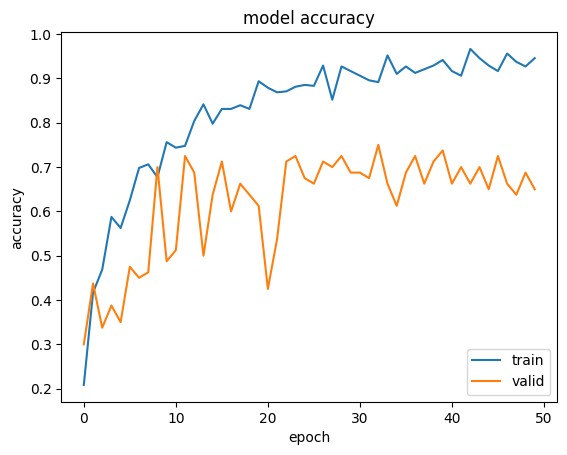

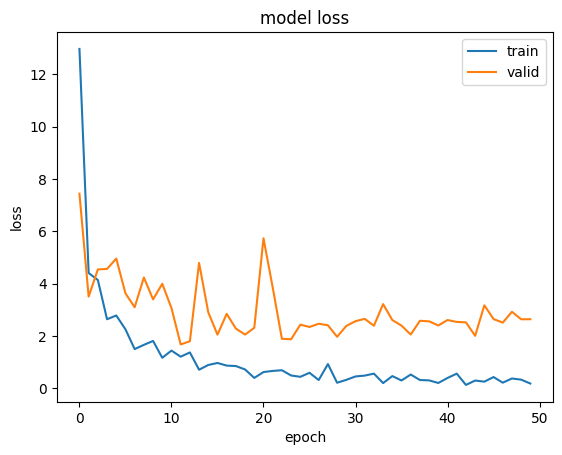

In [99]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'valid'], loc='lower right')
plt.show()
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'valid'], loc='upper right')
plt.show()

In [100]:
model.evaluate(validation_generator)

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step - accuracy: 0.6492 - loss: 2.5237


[2.6419732570648193, 0.6499999761581421]

As you can see, we reach a validation accuracy of over 66%.

#### Tensorboard

In [101]:
# Load the TensorBoard notebook extension on google colab
%load_ext tensorboard
%tensorboard --logdir logs

Output hidden; open in https://colab.research.google.com to view.

## 4.2 Fine Tuning

Another widely used technique for model reuse, complementary to feature extraction, is _fine-tuning_.
Fine-tuning consists of unfreezing a few of the top layers of a frozen model base used
for feature extraction, and jointly training both the newly added part of the model (in this case, the
fully connected classifier) and these top layers. This is called _fine-tuning_ because it slightly
adjusts the more abstract representations of the model being reused in order to make them more relevant for the problem at hand.

I stated earlier that it’s necessary to freeze the convolution base of VGG16 in order to be able to
train a randomly initialized classifier on top. For the same reason, it’s only possible to fine-tune the top
layers of the convolutional base once the classifier on top has already been trained. If the classifier isn’t
already trained, the error signal propagating through the network during training will be too
large, and the representations previously learned by the layers being fine-tuned will be destroyed. Thus
the steps for fine-tuning a network are as follows:

The steps for fine-tuning are as follows:

1. Add our custom network on top of an already-trained base network.
2. Freeze the base network.
3. Train the part we added.
4. Unfreeze some layers in the base network. (Note that you should not unfreeze “batch normalization” layers, which are not relevant here since there are no such layers in VGG16. )
5. Jointly train both these layers and the part we added.

We already completed the first three steps when doing feature extraction. Let’s proceed with step 4:
we’ll unfreeze our `conv_base` and then freeze individual layers inside it.

As a reminder, this is what our convolutional base looks like:

In [102]:
conv_base.summary()
model.summary()

Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_8 (InputLayer)           │ (None, None, None, 3)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, None, None, 64)      │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, None, None, 64)      │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, None, None, 64)      │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, None, None, 128)     │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, None, None, 128)     │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, None, None, 128)     │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, None, None, 256)     │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, None, None, 256)     │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, None, None, 256)     │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, None, None, 256)     │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, None, None, 512)     │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, None, None, 512)     │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, None, None, 512)     │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, None, None, 512)     │               0 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 14,714,688 (56.13 MB)

Model: "functional_53"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_9 (InputLayer)           │ (None, 150, 150, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ vgg16 (Functional)                   │ (None, 4, 4, 512)           │      14,714,688 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_3 (Flatten)                  │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 256)                 │       2,097,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_5 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 8)                   │           2,056 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 18,913,618 (72.15 MB)

 Trainable params: 2,099,464 (8.01 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

 Optimizer params: 2,099,466 (8.01 MB)

We will fine-tune the last three convolutional layers, which means all layers up to `block4_pool` should be frozen, and the layers `block5_conv1`, `block5_conv2`, and `block5_conv3` should be trainable.

Why not fine-tune more layers? Why not fine-tune the entire convolutional base?
You could. But you need to consider the following:

- Earlier layers in the convolutional base encode more generic, reusable features, whereas layers higher up encode more specialized features. It’s more useful to fine-tune the more specialized features, because these are the ones that need to be repurposed on your new problem. There would be fast-decreasing returns in fine-tuning lower layers.

- The more parameters you’re training, the more you’re at risk of overfitting. The convolutional base has 15 million parameters, so it would be risky to attempt to train it on your small dataset.

Thus, in this situation, it’s a good strategy to fine-tune only the top two or three layers in the convolutional base. Let’s set this up, starting from where we left off in the previous example.

#### Freezing all layers until the fourth from the last

In [103]:
conv_base.trainable = True
for layer in conv_base.layers[:-4]:
    layer.trainable = False

for layer in conv_base.layers[1:]:
    print('layer name = ' + layer.name + ', trainable = ' + repr(layer.trainable))



layer name = block1_conv1, trainable = False
layer name = block1_conv2, trainable = False
layer name = block1_pool, trainable = False
layer name = block2_conv1, trainable = False
layer name = block2_conv2, trainable = False
layer name = block2_pool, trainable = False
layer name = block3_conv1, trainable = False
layer name = block3_conv2, trainable = False
layer name = block3_conv3, trainable = False
layer name = block3_pool, trainable = False
layer name = block4_conv1, trainable = False
layer name = block4_conv2, trainable = False
layer name = block4_conv3, trainable = False
layer name = block4_pool, trainable = False
layer name = block5_conv1, trainable = True
layer name = block5_conv2, trainable = True
layer name = block5_conv3, trainable = True
layer name = block5_pool, trainable = True


Now we can begin fine-tuning the model. We’ll do this with the `RMSprop` optimizer, using a very low learning rate. The reason for using a low learning rate is that we want to limit the magnitude of the modifications we make to the representations of the three
layers we’re fine-tuning. Updates that are too large may harm these representations.

#### Fine-tuning the model

In [104]:
model.compile(loss="categorical_crossentropy",
    optimizer=keras.optimizers.RMSprop(learning_rate=1e-5),
    metrics=["accuracy"])

model.summary()

Model: "functional_53"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_9 (InputLayer)           │ (None, 150, 150, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ vgg16 (Functional)                   │ (None, 4, 4, 512)           │      14,714,688 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_3 (Flatten)                  │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 256)                 │       2,097,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_5 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 8)                   │           2,056 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 16,814,152 (64.14 MB)

 Trainable params: 9,178,888 (35.01 MB)

 Non-trainable params: 7,635,264 (29.13 MB)

In [105]:
logdir = os.path.join("logs_fine_tuning", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))


callbacks = [
    keras.callbacks.ModelCheckpoint(filepath="data/celebrities/fine_tuning.keras", save_best_only=True, monitor="val_loss"),
    tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)
]

history = model.fit(
train_generator,
epochs=30,
validation_data=validation_generator,
callbacks=callbacks
)

Epoch 1/30
15/15 ━━━━━━━━━━━━━━━━━━━━ 11s 442ms/step - accuracy: 0.9628 - loss: 0.1196 - val_accuracy: 0.6750 - val_loss: 2.6614
Epoch 2/30
15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 371ms/step - accuracy: 0.9774 - loss: 0.0693 - val_accuracy: 0.7375 - val_loss: 1.9683
Epoch 3/30
15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 349ms/step - accuracy: 0.9765 - loss: 0.0634 - val_accuracy: 0.7375 - val_loss: 2.2085
Epoch 4/30
15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 346ms/step - accuracy: 0.9901 - loss: 0.0427 - val_accuracy: 0.6875 - val_loss: 2.3197
Epoch 5/30
15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 348ms/step - accuracy: 0.9873 - loss: 0.0371 - val_accuracy: 0.7000 - val_loss: 2.1093
Epoch 6/30
15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 342ms/step - accuracy: 0.9990 - loss: 0.0135 - val_accuracy: 0.7125 - val_loss: 2.1190
Epoch 7/30
15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 339ms/step - accuracy: 0.9903 - loss: 0.0190 - val_accuracy: 0.7125 - val_loss: 2.0774
Epoch 8/30
15/15 ━━━━━━━━━━━━━━━━━━━━ 5s 341ms/step - accuracy: 0.9978 - loss: 0.0080 - val_accuracy: 0

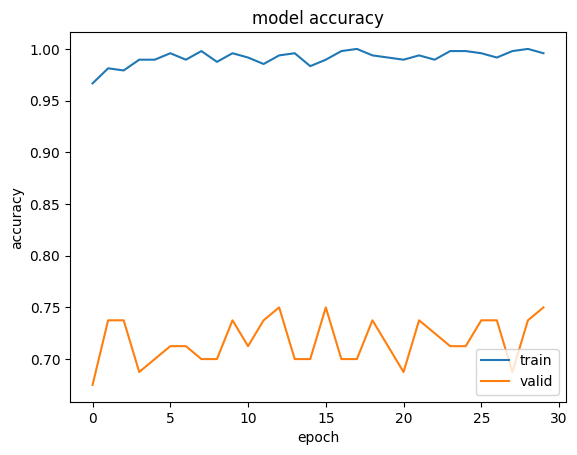

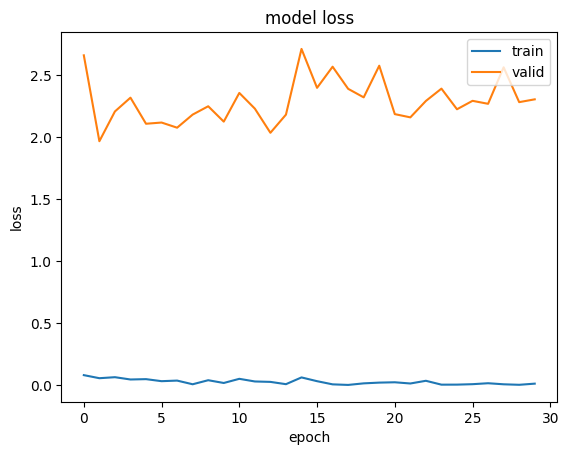

In [106]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'valid'], loc='lower right')
plt.show()
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'valid'], loc='upper right')
plt.show()

In [107]:
model.evaluate(validation_generator)

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step - accuracy: 0.7500 - loss: 2.2099


[2.3063533306121826, 0.75]

#### Tensorboard

In [108]:
# Load the TensorBoard notebook extension on google colab
%load_ext tensorboard
%tensorboard --logdir logs

Output hidden; open in https://colab.research.google.com to view.

### Confusion Matrix and Missclassified Images

In [109]:
prediction = model.predict(validation_dataset)

3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 336ms/step


In [110]:
val_features, val_labels = get_features_and_labels(validation_dataset)
num_valid_images, _ = val_labels.shape
num_classes = 8

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step


In [111]:
from sklearn.metrics import confusion_matrix
import sys

Y_valid = np.zeros((num_valid_images,1),dtype=int)

step = num_valid_images // num_classes
for ind in range(num_classes):
    Y_valid[ind*step:(ind+1)*step] = ind

confmat = confusion_matrix(val_labels.argmax(axis=1),np.argmax(prediction,axis=1))

for i0 in range(num_classes):
    sys.stdout.write('[')
    for i1 in range(num_classes):
        sys.stdout.write('{:3d} '.format(confmat[i0,i1]))

    sys.stdout.write('], {}\n'.format(class_names[i0]))

sys.stdout.flush()

[  6   0   0   0   0   3   0   1 ], angelina jolie
[  0   1   0   6   2   1   0   0 ], brad pitt
[  3   0   1   0   0   5   0   1 ], catherine deneuve
[  0   1   0   8   0   1   0   0 ], johnny depp
[  2   0   0   3   3   1   1   0 ], leonardo dicaprio
[  6   0   0   0   0   3   0   1 ], marion cotillard
[  0   1   0   2   2   0   5   0 ], robert de niro
[  5   0   0   0   0   3   0   2 ], sandra bullock


wrong classification for: sandra bullock


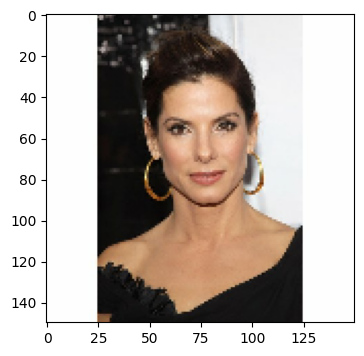

matched to: marion cotillard


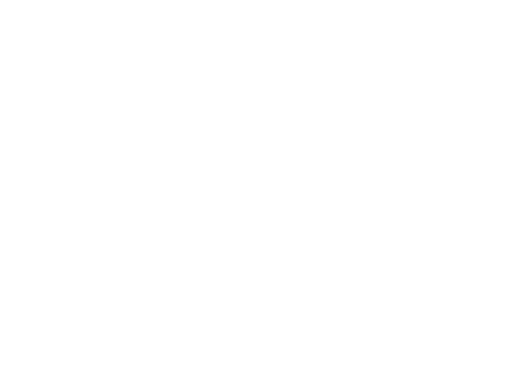

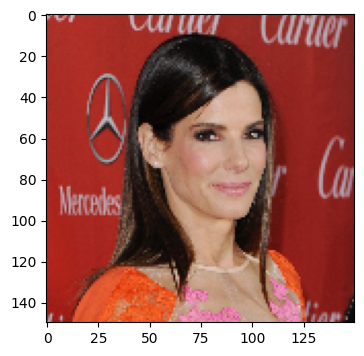

matched to: angelina jolie


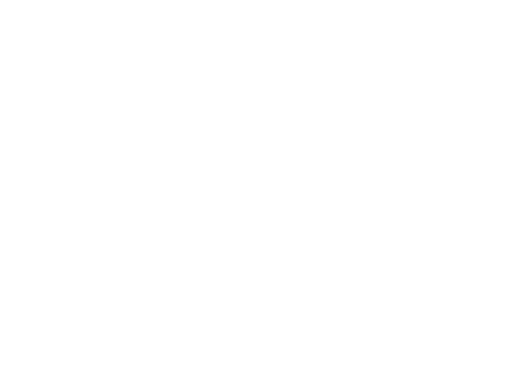

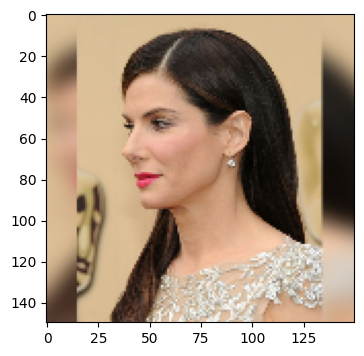

matched to: angelina jolie


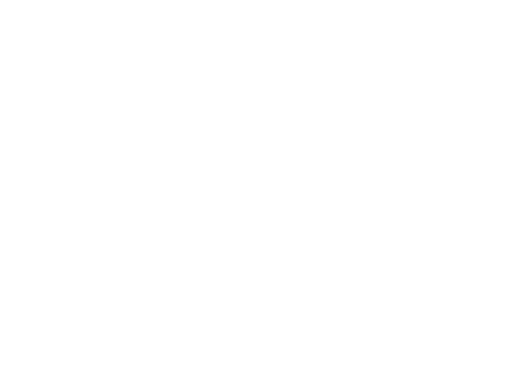

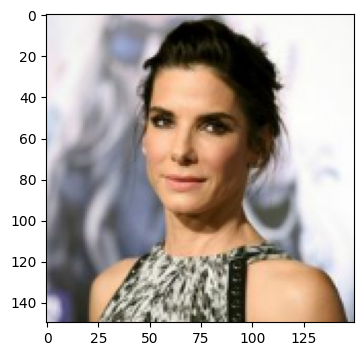

matched to: marion cotillard


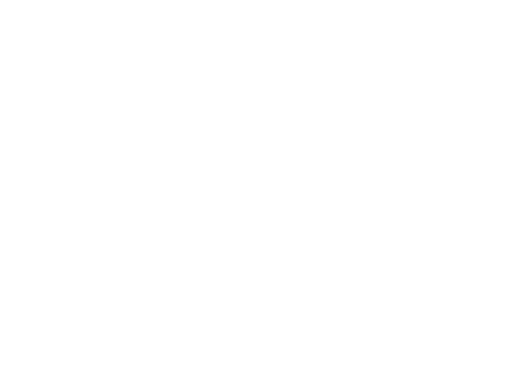

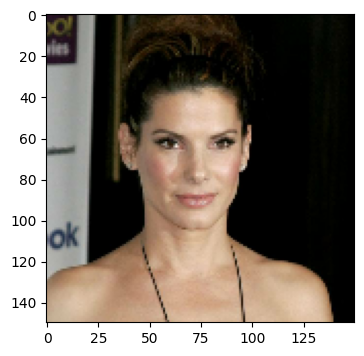

matched to: angelina jolie


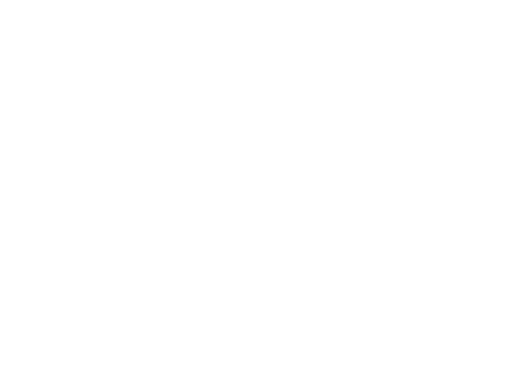

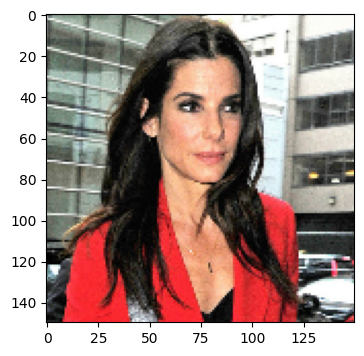

matched to: marion cotillard


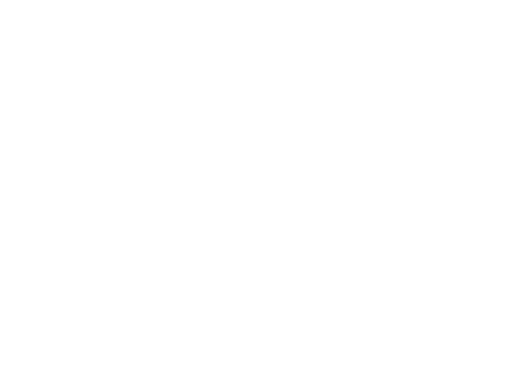

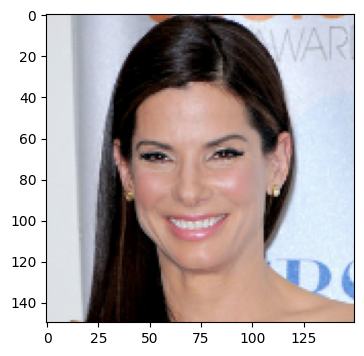

matched to: angelina jolie


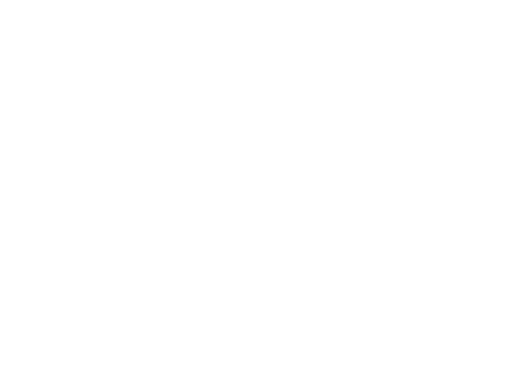

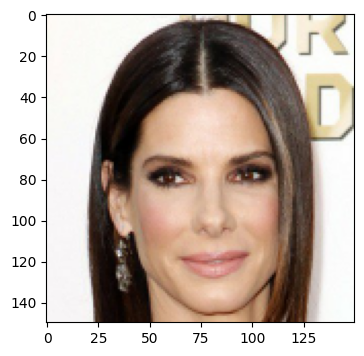

matched to: angelina jolie


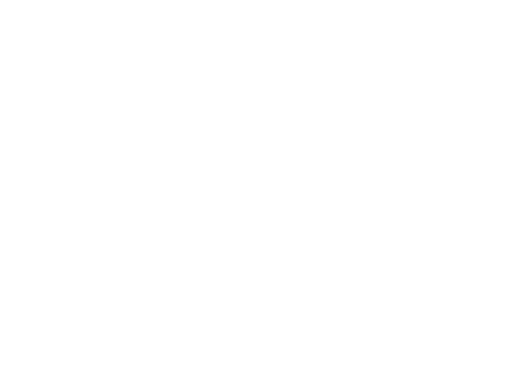

In [112]:
# Choose the class label you want to check
clbl = 7
step = num_valid_images // num_classes
pred_labels = np.argmax(prediction[clbl*step:(clbl+1)*step],axis=1)
wrong_labels = np.transpose(np.nonzero(pred_labels != clbl))


# Get the validation images as numpy arrays

import numpy as np
def get_images_and_labels(dataset):
    all_images = []
    all_labels = []
    for images, labels in dataset:
        all_images.append(images)
        all_labels.append(labels)
    return np.concatenate(all_images), np.concatenate(all_labels)

val_images, val_labels = get_images_and_labels(validation_dataset)


print('wrong classification for: {}'.format(class_names[clbl]))

for i, i0 in enumerate(wrong_labels):
    img = val_images[clbl*step + i0]
    img = np.squeeze(img, axis=0)
    plt.figure(figsize=(4, 4))
    plt.imshow(img.astype("uint8"))
    plt.show()
    plt.axis("off")
    print('matched to: {}'.format(class_names[pred_labels[i0][0]]))
